In [ ]:
# import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

file_list = ["corruption","foodweb-baywet","inf-USAir97","moreno_crime_projected"]
path = "/home/bhandk/Desktop/MAS/FINDER/"
for name in file_list:
    GRAPH = nx.read_adjlist("./real/"+name+".txt")
    GRAPH = nx.convert_node_labels_to_integers(GRAPH)
    fname = path+name+".txt"
    initial_lcc = len(max(nx.connected_components(GRAPH), key=len))
    lcc = []
    action_list = np.loadtxt(fname, dtype=int)
    for action in action_list:  
        GRAPH.remove_node(action)
        largest_cc = (len(max(nx.connected_components(GRAPH), key=len))/initial_lcc)
        lcc.append(largest_cc)
    plt.plot(lcc, 'orange', label='FINDER')
    plt.legend()
    plt.title("LCC vs No. of Nodes for Finder  -"+ name +" Dataset")
    plt.show()

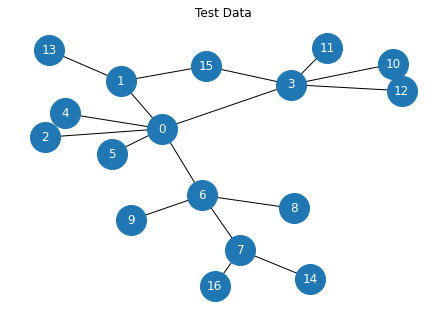

In [5]:
G = nx.Graph()
G.add_edge(0, 1)
G.add_edge(0, 2)
G.add_edge(0, 3)
G.add_edge(0, 4)
G.add_edge(0, 5)
G.add_edge(0, 6)
G.add_edge(1, 13)
G.add_edge(1, 15)
G.add_edge(3, 10)
G.add_edge(3, 11)
G.add_edge(3, 12)
G.add_edge(3, 15)
G.add_edge(6, 7)
G.add_edge(6, 8)
G.add_edge(6, 8)
G.add_edge(6, 9)
G.add_edge(7, 16)
G.add_edge(7, 14)
nx.draw(G,nodelist=G.nodes, font_color='white' ,node_size = 900, with_labels=True)
nx.write_edgelist(G, '/home/bhandk/Desktop/MAS/real/test.txt')
plt.title("Test Data")
plt.savefig("test")

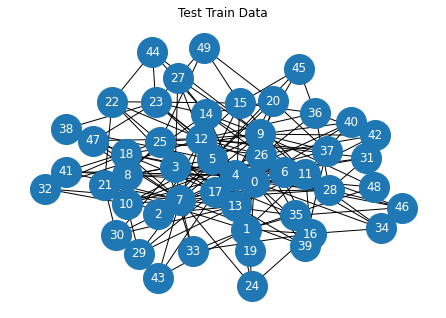

In [3]:
import networkx as nx
import matplotlib.pyplot as plt
G = nx.barabasi_albert_graph(n=50, m=4)
nx.draw(G,nodelist=G.nodes, font_color='white' ,node_size = 900, with_labels=True)
nx.write_edgelist(G, '/home/bhandk/Desktop/MAS/real/testTrain.txt')
plt.title("Test Train Data")
plt.savefig("testTrain")

In [1]:
import networkx as nx
import matplotlib.pyplot as plt
fh = open("real/testTrain.txt", "rb")
GRAPH = nx.read_edgelist(fh)
fh.close()
nodes = GRAPH.nodes()
map = {n:int(n) for n in nodes}
GRAPH = nx.relabel_nodes(GRAPH, map)
#print(GRAPH.degree())
plt.figure(figsize=(20, 20), dpi=120)
nx.draw(GRAPH,nodelist=GRAPH.nodes, font_color='white' ,node_size = 900, with_labels=True)
#plt.savefig("/home/bhandk/testTrain")
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'real/testTrain.txt'

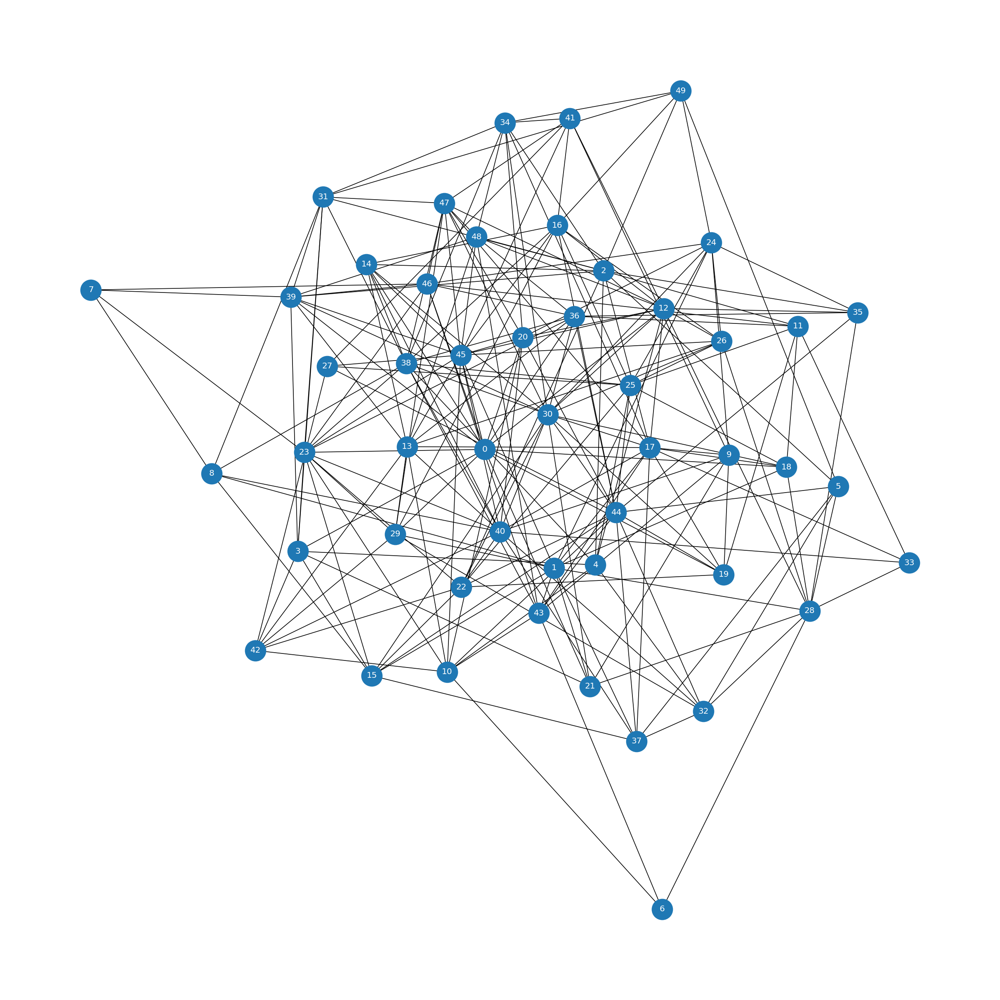

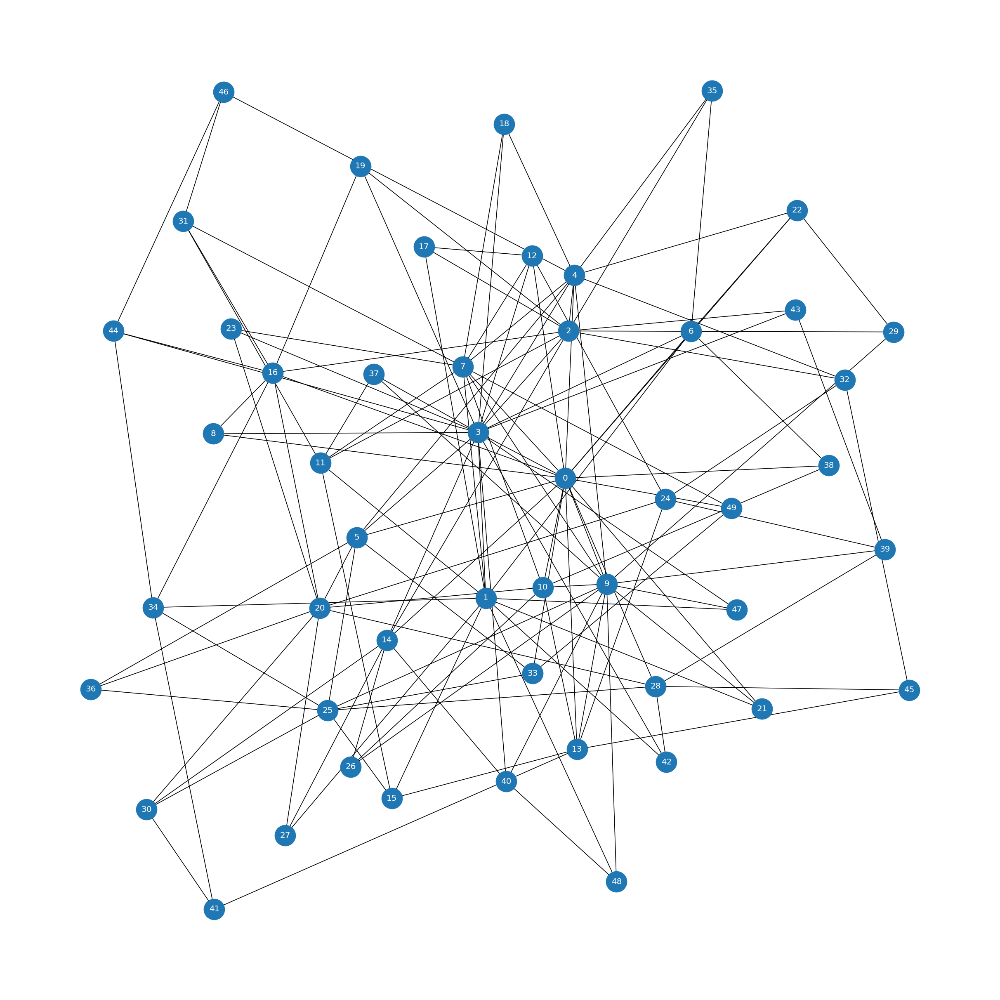

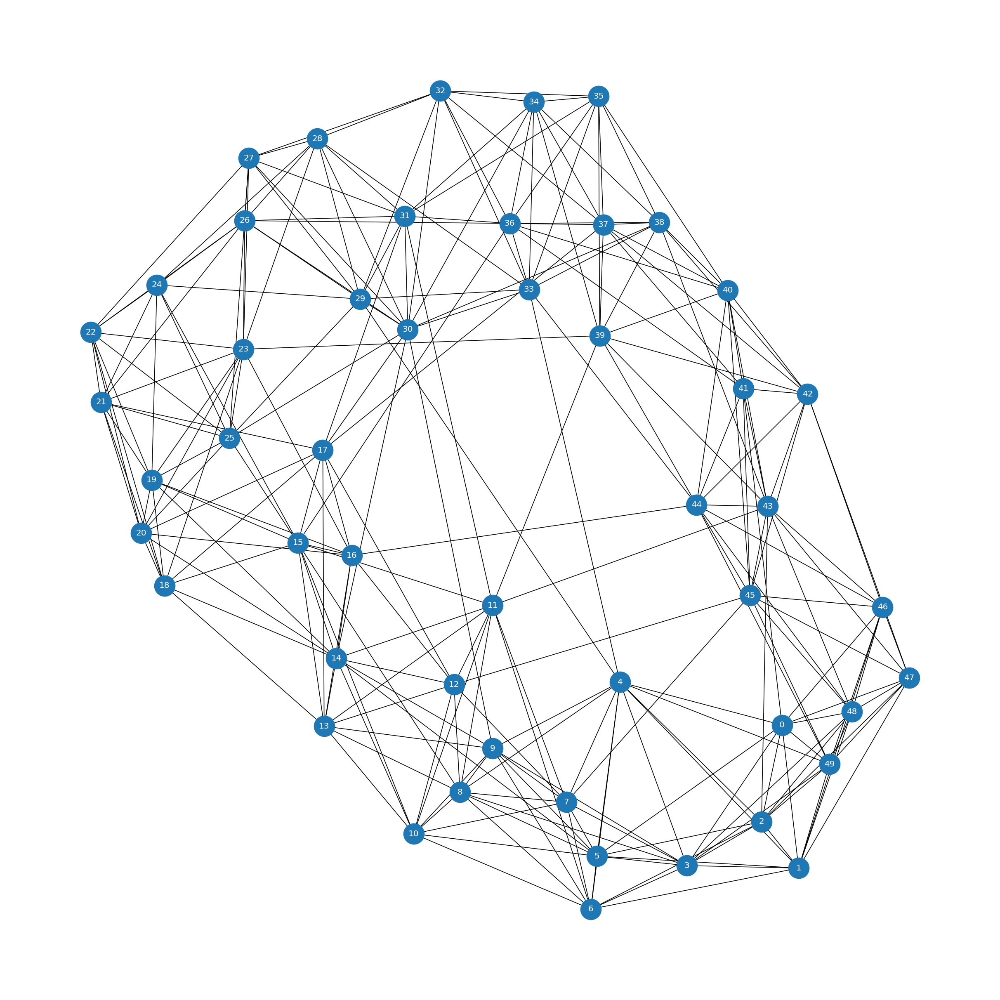

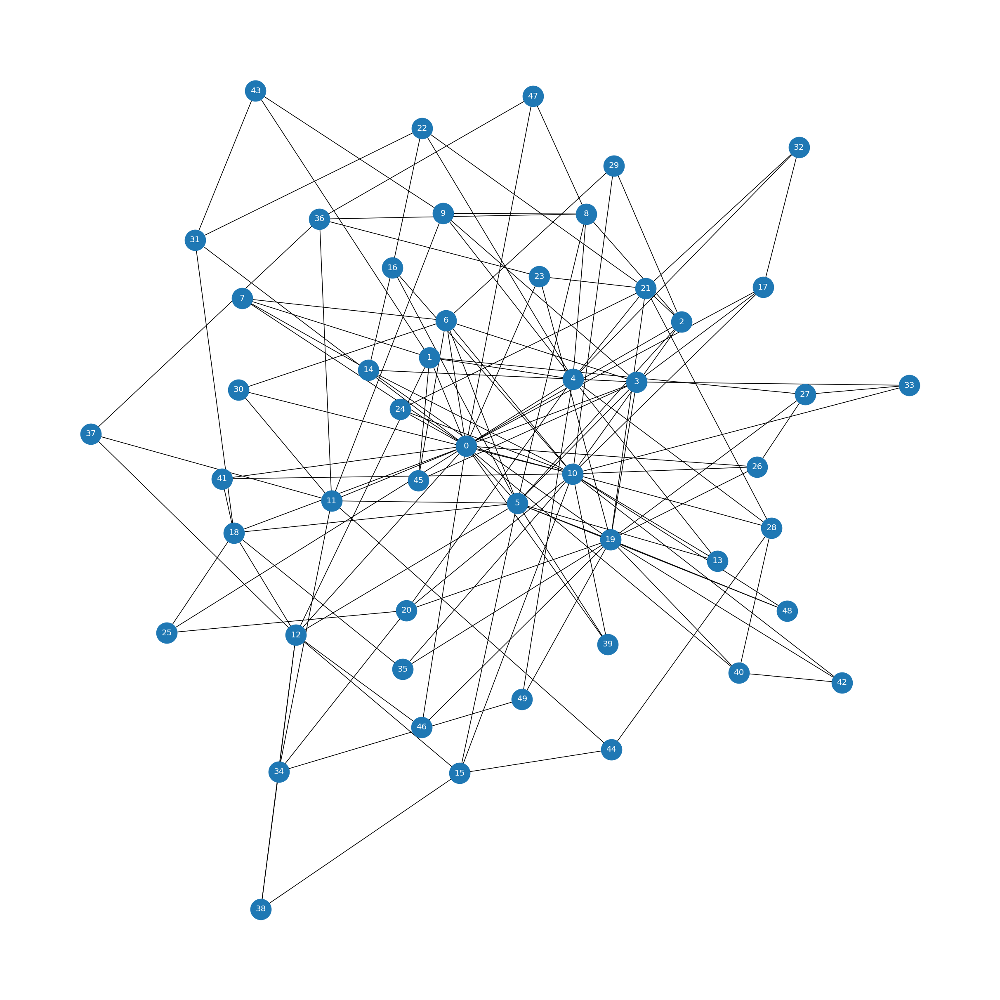

In [2]:
import random
import networkx as nx
def gen_graph(cur_n, g_type):
    if g_type == 'erdos_renyi':
        g = nx.erdos_renyi_graph(n=cur_n, p=random.uniform(0.05,0.25))
    elif g_type == 'powerlaw':
        g = nx.powerlaw_cluster_graph(n=cur_n, m=random.randint(2,4), p=random.uniform(0.01,0.1))
    elif g_type == 'small-world':
        g = nx.connected_watts_strogatz_graph(n=cur_n, k=random.randint(5,10), p=random.uniform(0.01,0.2))
    elif g_type == 'barabasi_albert':
        g = nx.barabasi_albert_graph(n=cur_n, m=random.randint(3,5))
    return g

graph_type = ['erdos_renyi', 'powerlaw','small-world', 'barabasi_albert']
for g_tp in graph_type:
    g = gen_graph(50,g_tp)
    plt.figure(figsize=(15, 20), dpi=120)
    nx.draw(g,nodelist=g.nodes, font_color='white' ,node_size = 900, with_labels=True)
    #plt.savefig("/home/bhandk/testTrain")
    plt.show()

In [7]:
import imageio
filenames=['/home/bhandk/Desktop/MAS/figure/0/'+str(i)+'.png' for i in range(18)]
title = "demo"+'.gif'
with imageio.get_writer(title, mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Create Synthetic Dataset

In [22]:
import networkx as nx
import matplotlib.pyplot as plt
def gen_graph(cur_n, g_type):
    if g_type == 'erdos_renyi':
        g = nx.erdos_renyi_graph(n=cur_n, p=0.1)
    elif g_type == 'powerlaw':
        g = nx.powerlaw_cluster_graph(n=cur_n, m=3, p=0.05)
    elif g_type == 'small-world':
        g = nx.connected_watts_strogatz_graph(n=cur_n, k=5, p=0.1)
    elif g_type == 'barabasi_albert':
        g = nx.barabasi_albert_graph(n=cur_n, m=2)
    return g
number = 1 
graph_type = ['erdos_renyi', 'powerlaw','small-world', 'barabasi_albert']
noderange = [30, 50, 100, 500]
for graphtype in graph_type:
    for nodesize in noderange:
        G = gen_graph(nodesize, graphtype)
        filename = graphtype+'_'+str(nodesize)+'_'+str(number)
        #plt.figure(figsize=(15, 20), dpi=120)
        #nx.draw(G,nodelist=G.nodes, font_color='white' ,node_size = 900, with_labels=True)
        #plt.savefig('/home/bhandk/Desktop/MAS/SyntheticGraph/Synthetic_Figure/'+filename)
        nx.write_edgelist(G, '/home/bhandk/Desktop/MAS/SyntheticGraph/'+filename+'.txt')

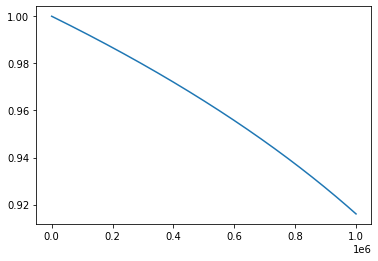

In [13]:
import matplotlib.pyplot as plt

def _get_epsilon(_epsilon_start, _epsilon_end,_step_counter, _epsilon_decay_duration,power):
    decay_steps = min(_step_counter, _epsilon_decay_duration)
    decayed_epsilon = (
        _epsilon_end + (_epsilon_start - _epsilon_end) *
        (1 - decay_steps /_epsilon_decay_duration)**power)
    return decayed_epsilon
ep = []
for _step_counter in range(int(1e6)):
    _epsilon_start, _epsilon_end, _epsilon_decay_duration,power= 1.0,0.15,int(2e6),0.15
    ep.append(_get_epsilon(_epsilon_start, _epsilon_end,_step_counter, _epsilon_decay_duration,power))
plt.plot(ep)
plt.show()

# Properties of Real World Network

In [3]:
import networkx as nx
import numpy as np
def molloy_reed(g):
  all_degree =   np.array(g.degree())[:,1]
  degs = np.delete(all_degree,-1)
  k = degs.mean()
  k2 = np.mean(degs ** 2)
  if k ==0:
    beta = 0
  else:
    beta = k2/k
  return beta
def global_feature(g): 
    subGraph = g.subgraph(np.arange(len(g)-1)) #for supernode
    M = len(subGraph.edges())
    N = len(subGraph)
    degs =   np.array(subGraph.degree())[:,1]
    k1 = degs.mean()
    k2 = np.mean(degs** 2)
    div = k2 - k1**2
    nodes = M
    edges = N
    heterogeneity = div/k1
    density = (2*M)/(N*(N-1))
    resilience = molloy_reed(g)
    global_properties = np.hstack((nodes, edges,density,resilience,heterogeneity)).astype(float)
    return global_properties
#file_list = ["test","testTrain","corruption","foodweb-baywet","inf-USAir97","moreno_crime_projected",'opsahl-openflights','household','faa','facebook','powergrid','netscience']
file_list=[]
homogeneity = ['homogeneous','heterogeneous']
noderange = [30, 50, 100, 500]
for graphtype in homogeneity:
        for nodesize in noderange:
                file_list.append(graphtype+'_'+str(nodesize))
properties=[]
for name in file_list:
    fh = open("../HomogeneityGraph/"+name+".txt", "rb")
    GRAPH = nx.read_edgelist(fh)
    fh.close()
    nodes = GRAPH.nodes()
    map = {n:int(i) for i, n in enumerate(nodes)}
    GRAPH = nx.relabel_nodes(GRAPH, map)
    properties.append([name,global_feature(GRAPH)])
print(properties)

[['homogeneous_30', array([47.        , 28.        ,  0.12433862,  3.69473684,  0.28115502])], ['homogeneous_50', array([7.70000000e+01, 4.90000000e+01, 6.54761905e-02, 3.64516129e+00,
       4.80519481e-01])], ['homogeneous_100', array([1.48000000e+02, 9.30000000e+01, 3.45956054e-02, 3.95973154e+00,
       7.63150247e-01])], ['homogeneous_500', array([7.86000000e+02, 4.65000000e+02, 7.28587319e-03, 4.17228226e+00,
       7.80932447e-01])], ['heterogeneous_30', array([30.        , 22.        ,  0.12987013,  3.32786885,  0.53939394])], ['heterogeneous_50', array([48.        , 35.        ,  0.08067227,  3.32      ,  0.48630952])], ['heterogeneous_100', array([1.17000000e+02, 7.50000000e+01, 4.21621622e-02, 4.25957447e+00,
       1.07658120e+00])], ['heterogeneous_500', array([6.38000000e+02, 4.13000000e+02, 7.49900092e-03, 4.36726703e+00,
       1.25837400e+00])]]


# Different Homophiliy

In [19]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np


def molloy_reed(g):
  all_degree =   np.array(g.degree())[:,1]
  degs = np.delete(all_degree,-1)
  k = degs.mean()
  k2 = np.mean(degs ** 2)
  if k ==0:
    beta = 0
  else:
    beta = k2/k
  return beta
def global_feature(g): 
    subGraph = g#g.subgraph(np.arange(len(g)-1)) #for supernode
    M = len(subGraph.edges())
    N = len(subGraph)
    degs =   np.array(subGraph.degree())[:,1]
    k1 = degs.mean()
    k2 = np.mean(degs** 2)
    div = k2 - k1**2
    heterogeneity = div/k1
    density = (2*M)/(N*(N-1))
    resilience = molloy_reed(g)
    #global_properties = np.hstack((nodes, edges,density,resilience,heterogeneity)).astype(float)
    global_properties = np.hstack((N, M,density,resilience,heterogeneity))
    return global_properties

def gen_graph(cur_n, g_type):
    if g_type == 'erdos_renyi':
        g = nx.erdos_renyi_graph(n=cur_n, p=0.1)
    elif g_type == 'powerlaw':
        g = nx.powerlaw_cluster_graph(n=cur_n, m=3, p=0.05)
    elif g_type == 'small-world':
        g = nx.connected_watts_strogatz_graph(n=cur_n, k=5, p=0.1)
    elif g_type == 'barabasi_albert':
        g = nx.barabasi_albert_graph(n=cur_n, m=3)
    return g
number = 1 
graph_type = ['barabasi_albert']
noderange = [30, 50, 100, 500]
properties = []
for graphtype in graph_type:
    for nodesize in noderange:
        G = gen_graph(nodesize, graphtype)
        filename = graphtype+'_'+str(nodesize)+'_'+str(number)
        #plt.figure(figsize=(15, 20), dpi=120)
        #nx.draw(G,nodelist=G.nodes, font_color='white' ,node_size = 900, with_labels=True)
        #plt.savefig('/home/bhandk/Desktop/MAS/SyntheticGraph/Synthetic_Figure/'+filename)
        #nx.write_edgelist(G, '/home/bhandk/Desktop/MAS/SyntheticGraph/'+filename+'.txt')
        print(global_feature(G))

[30.         81.          0.1862069   6.96226415  1.48888889]
[5.00000000e+01 1.41000000e+02 1.15102041e-01 8.37634409e+00
 2.67914894e+00]
[1.00000000e+02 2.91000000e+02 5.87878788e-02 9.38341969e+00
 3.53051546e+00]
[5.00000000e+02 1.49100000e+03 1.19519038e-02 1.45427996e+01
 8.56718712e+00]


# Create Heterogeneous CV graph

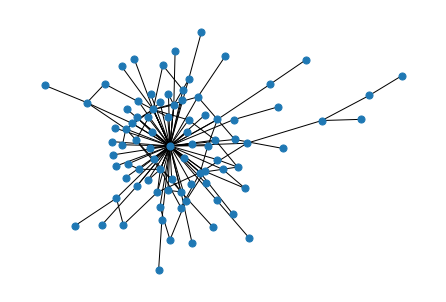

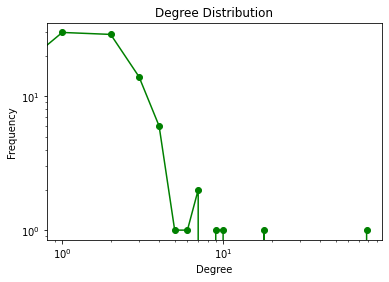

heterogeneous_0 [8.70000000e+01 1.47000000e+02 3.92943063e-02 2.43561644e+01
 2.08247713e+01]


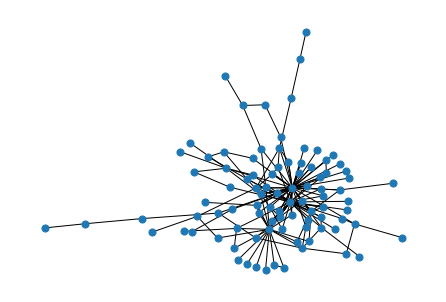

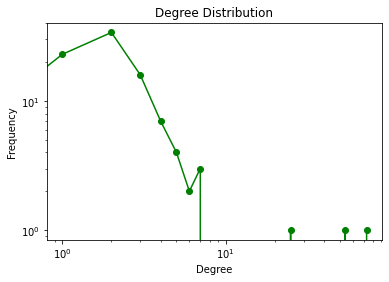

heterogeneous_1 [9.2000000e+01 1.8600000e+02 4.4433827e-02 2.5884097e+01 2.1773726e+01]


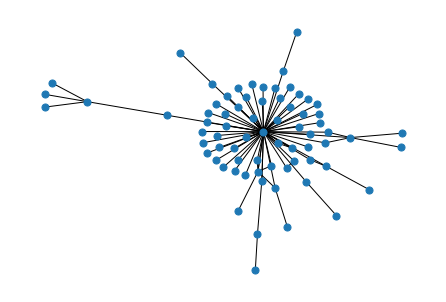

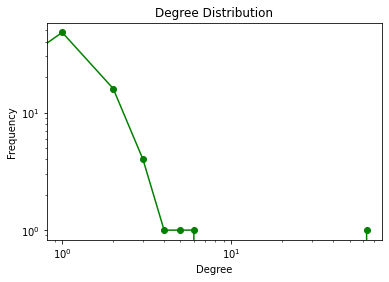

heterogeneous_2 [7.20000000e+01 8.50000000e+01 3.32550861e-02 2.48106509e+01
 2.23094771e+01]


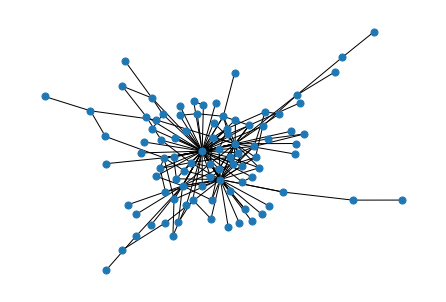

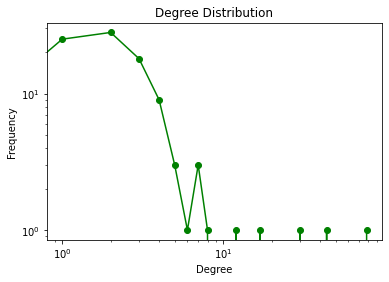

heterogeneous_3 [9.30000000e+01 2.01000000e+02 4.69845722e-02 2.52294264e+01
 2.08465736e+01]


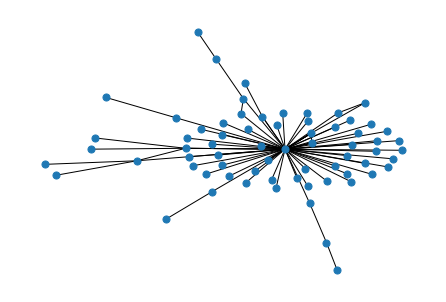

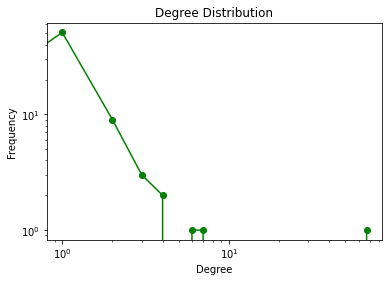

heterogeneous_4 [6.80000000e+01 8.30000000e+01 3.64354697e-02 2.86000000e+01
 2.59925585e+01]


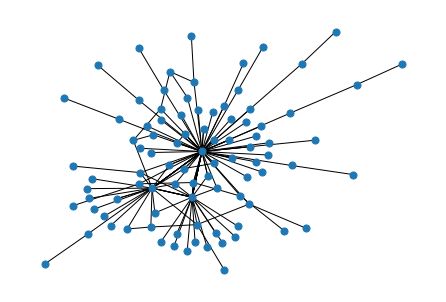

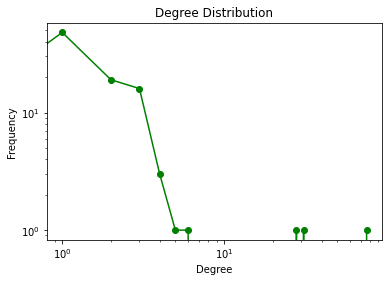

heterogeneous_5 [9.10000000e+01 1.46000000e+02 3.56532357e-02 2.72206897e+01
 2.38391540e+01]


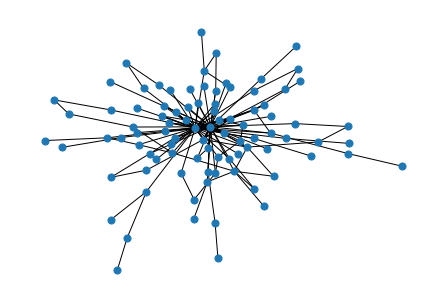

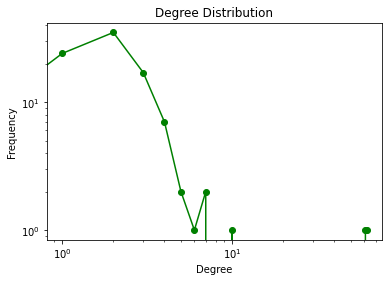

heterogeneous_6 [9.10000000e+01 1.68000000e+02 4.10256410e-02 2.47074627e+01
 2.09445971e+01]


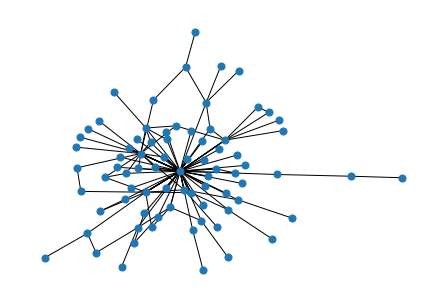

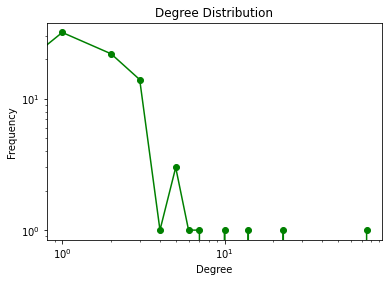

heterogeneous_7 [7.80000000e+01 1.36000000e+02 4.52880453e-02 2.54370370e+01
 2.17775264e+01]


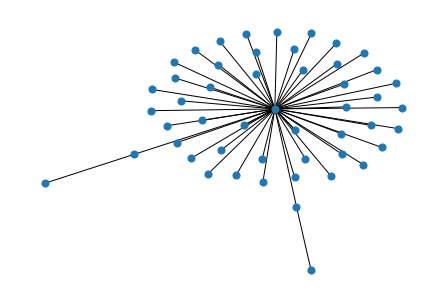

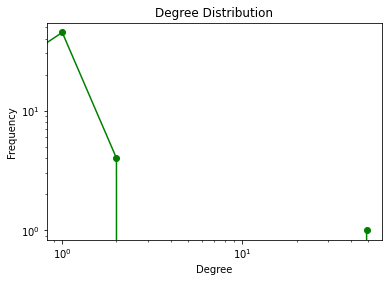

heterogeneous_8 [5.00000000e+01 5.10000000e+01 4.16326531e-02 2.43663366e+01
 2.20972549e+01]


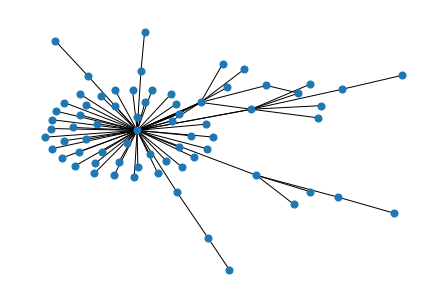

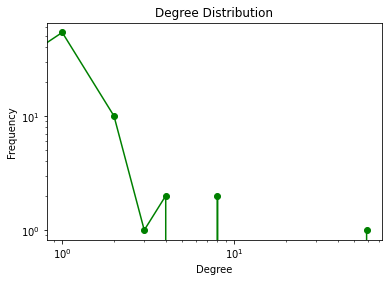

heterogeneous_9 [7.00000000e+01 8.00000000e+01 3.31262940e-02 2.35408805e+01
 2.11142857e+01]


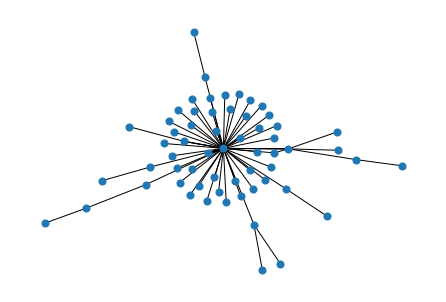

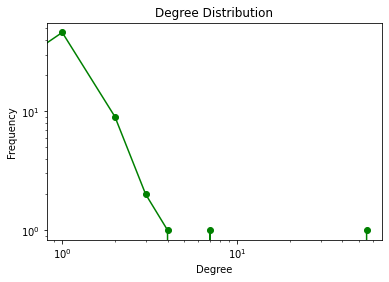

heterogeneous_10 [6.00000000e+01 6.80000000e+01 3.84180791e-02 2.36222222e+01
 2.11892157e+01]


In [12]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

def molloy_reed(g):
  all_degree =   np.array(g.degree())[:,1]
  degs = np.delete(all_degree,-1)
  k = degs.mean()
  k2 = np.mean(degs ** 2)
  if k ==0:
    beta = 0
  else:
    beta = k2/k
  return beta
def global_feature(g): 
    subGraph = g#g.subgraph(np.arange(len(g)-1)) #for supernode
    M = len(subGraph.edges())
    N = len(subGraph)
    degs =   np.array(subGraph.degree())[:,1]
    k1 = degs.mean()
    k2 = np.mean(degs** 2)
    div = k2 - k1**2
    nodes = N
    edges = M
    heterogeneity = div/k1
    density = (2*M)/(N*(N-1))
    resilience = molloy_reed(g)
    global_properties =np.hstack((nodes, edges,density,resilience,heterogeneity)).astype(float)
    return global_properties

def create_heterogeneous_graph(deg,i,num):
    #create a graph with degrees following a power law distribution
    G = nx.expected_degree_graph(deg, selfloops=False)
    G = G.subgraph(max(nx.connected_components(G), key=len))
    sequence = [val for (node, val) in G.degree()]
    #sequence = nx.random_powerlaw_tree_sequence(100,i, tries=5000)
    G_conf = nx.configuration_model(sequence)   
    G_conf.remove_edges_from(nx.selfloop_edges(G_conf))
    G_conf = G_conf.subgraph(max(nx.connected_components(G_conf), key=len))
    feature = global_feature(G_conf)
    cond = True
    if feature[-1] >=20:
        nx.draw(G_conf,nodelist=G_conf.nodes, font_color='white' ,node_size = 50, with_labels=False)
        file_name =  "../Cross_Validation/heterogeneous_"+str(num)
        nx.write_edgelist(G_conf,file_name+str(".txt"))
        plt.savefig(file_name)
        plt.show()
        degree_freq = nx.degree_histogram(G_conf)
        degrees = range(len(degree_freq))
        plt.loglog(degrees, degree_freq,'go-') 
        plt.xlabel('Degree')
        plt.ylabel('Frequency')
        plt.title("Degree Distribution")
        file_name =  "../Cross_Validation/heterogeneous_degree_"
        plt.savefig(file_name+str(num))
        plt.show()
        cond = False
        print("heterogeneous_"+str(num),feature)
    return cond

#for i in np.arange(2.0,3.2,0.2):
cond = True
num = 0 
while cond:
    i = 2.0
    deg = nx.utils.powerlaw_sequence(100, i) #100 nodes, power-law exponent 2.5
    #deg = nx.random_powerlaw_tree_sequence(100, tries=5000)
    cond = create_heterogeneous_graph(deg,i,num)
    if not(cond):
        num += 1
        cond = True
        if num > 10 :
            cond = False


# Create Homogeneous CV graph

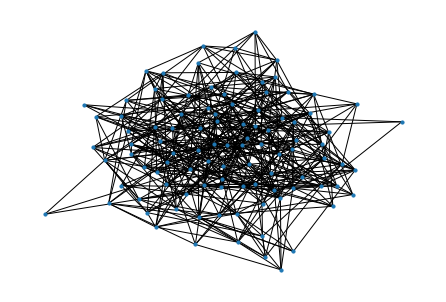

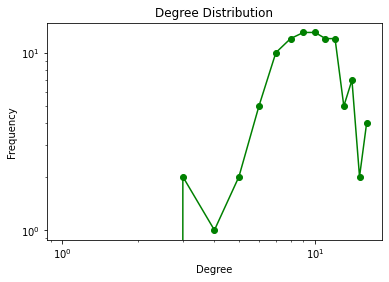

homogeneous_0 [1.00000000e+02 4.98000000e+02 1.00606061e-01 1.07971602e+01
 8.29156627e-01]


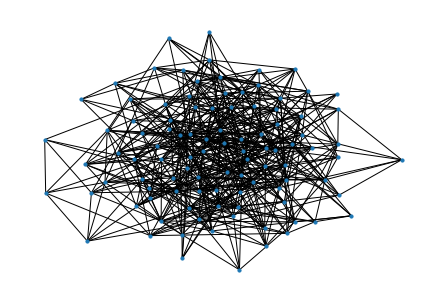

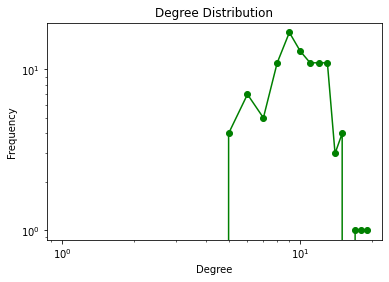

homogeneous_1 [1.00000000e+02 5.10000000e+02 1.03030303e-01 1.10118694e+01
 7.94117647e-01]


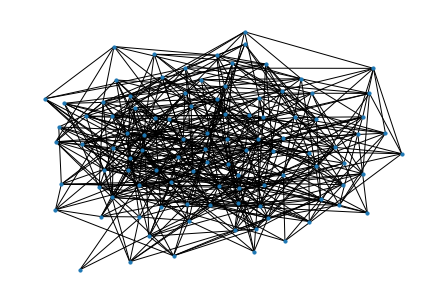

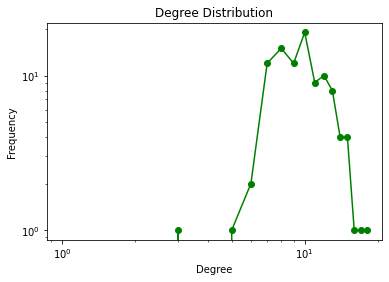

homogeneous_2 [1.00000000e+02 5.06000000e+02 1.02222222e-01 1.08525896e+01
 7.10039526e-01]


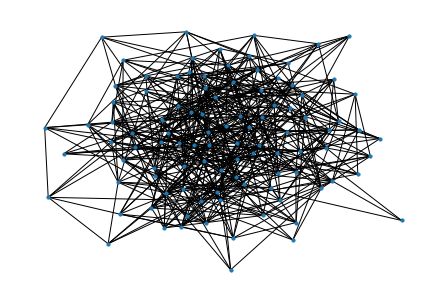

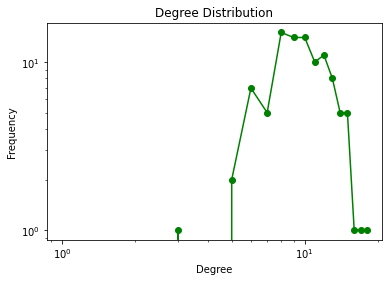

homogeneous_3 [1.00000000e+02 5.09000000e+02 1.02828283e-01 1.09960396e+01
 7.92495088e-01]


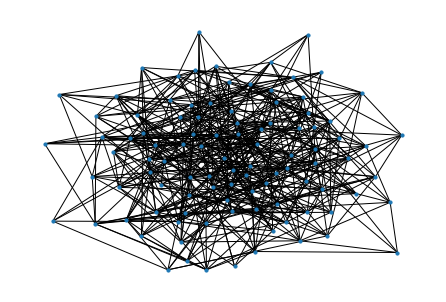

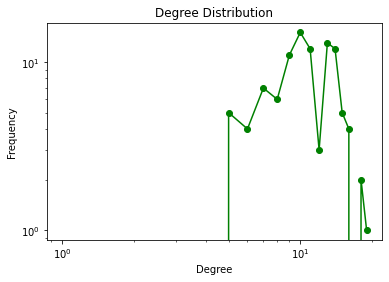

homogeneous_4 [1.00000000e+02 5.47000000e+02 1.10505051e-01 1.18866359e+01
 9.22888483e-01]


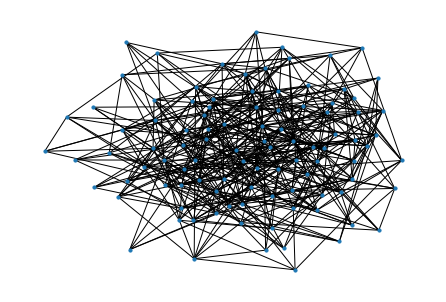

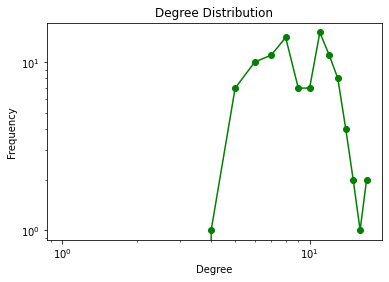

homogeneous_5 [1.00000000e+02 4.79000000e+02 9.67676768e-02 1.05424974e+01
 9.33569937e-01]


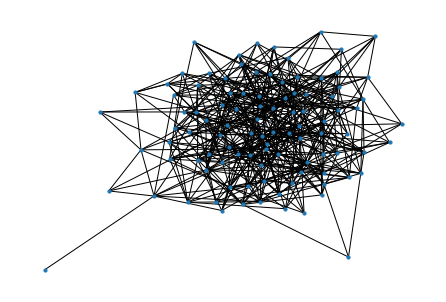

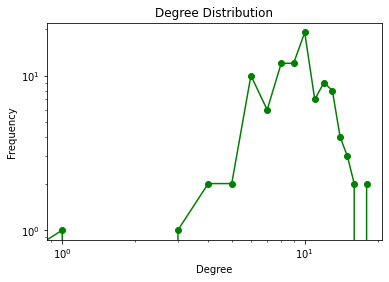

homogeneous_6 [1.00000000e+02 4.88000000e+02 9.85858586e-02 1.06221294e+01
 9.98196721e-01]


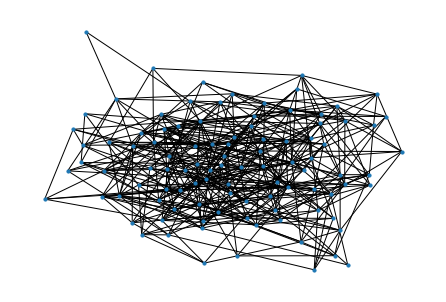

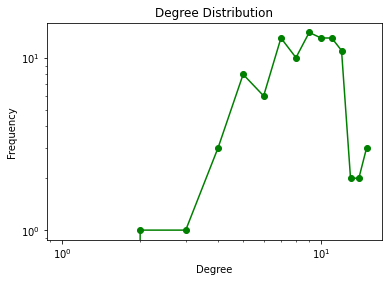

homogeneous_7 [1.00000000e+02 4.47000000e+02 9.03030303e-02 9.81306306e+00
 8.47472036e-01]


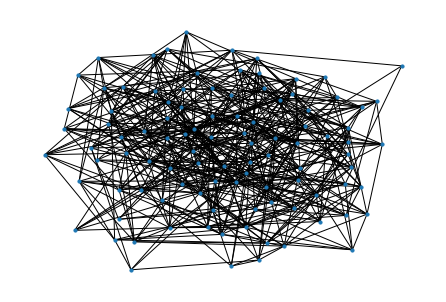

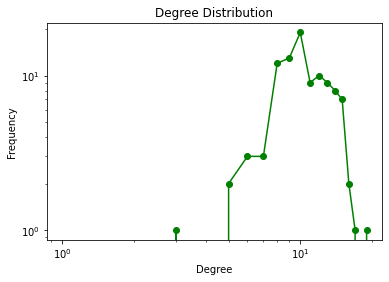

homogeneous_8 [1.00000000e+02 5.38000000e+02 1.08686869e-01 1.14967074e+01
 7.54869888e-01]


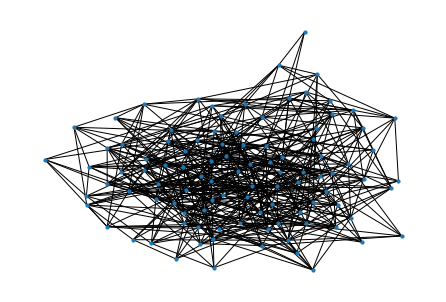

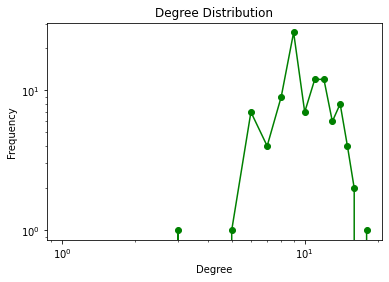

homogeneous_9 [1.00000000e+02 5.15000000e+02 1.04040404e-01 1.10547945e+01
 7.31067961e-01]


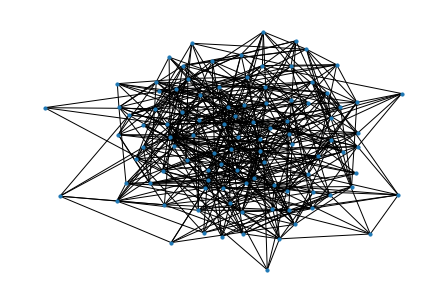

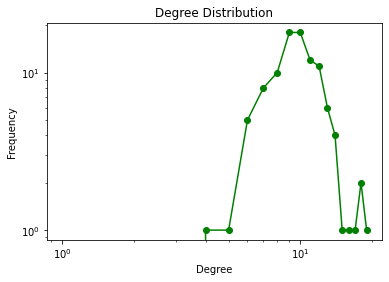

homogeneous_10 [1.00000000e+02 5.09000000e+02 1.02828283e-01 1.09504950e+01
 7.47308448e-01]


In [10]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

def molloy_reed(g):
  all_degree =   np.array(g.degree())[:,1]
  degs = np.delete(all_degree,-1)
  k = degs.mean()
  k2 = np.mean(degs ** 2)
  if k ==0:
    beta = 0
  else:
    beta = k2/k
  return beta
def global_feature(g): 
    subGraph = g#g.subgraph(np.arange(len(g)-1)) #for supernode
    M = len(subGraph.edges())
    N = len(subGraph)
    degs =   np.array(subGraph.degree())[:,1]
    k1 = degs.mean()
    k2 = np.mean(degs** 2)
    div = k2 - k1**2
    nodes = N
    edges = M
    heterogeneity = div/k1
    density = (2*M)/(N*(N-1))
    resilience = molloy_reed(g)
    global_properties =np.hstack((nodes, edges,density,resilience,heterogeneity)).astype(float)
    return global_properties

def create_homogeneous_graph(num):
    #create a graph with degrees following a power law distribution
    G_conf = nx.erdos_renyi_graph(n=100, p=0.1)
    feature = global_feature(G_conf)
    cond = True
    if feature[-1] <=1:
        nx.draw(G_conf,nodelist=G_conf.nodes, font_color='white' ,node_size = 10, with_labels=False)
        file_name =  "../Cross_Validation/homogeneous_"+str(num)
        nx.write_edgelist(G_conf,file_name+str(".txt"))
        plt.savefig(file_name)
        plt.show()
        degree_freq = nx.degree_histogram(G_conf)
        degrees = range(len(degree_freq))
        plt.loglog(degrees, degree_freq,'go-') 
        plt.xlabel('Degree')
        plt.ylabel('Frequency')
        plt.title("Degree Distribution")
        file_name_deg =  "../Cross_Validation/homogeneous_degree_"
        plt.savefig(file_name_deg+str(num))
        plt.show()
        cond = False
        print("homogeneous_"+str(num),feature)
    return cond

#for i in np.arange(2.0,3.2,0.2):
cond = True
num = 0 
while cond:
    cond = create_homogeneous_graph(num)
    if not(cond):
        num += 1
        cond = True
        if num > 10 :
            cond = False


## Generate Synthetic Graph: GNNExplainer

In [108]:
%matplotlib inline
"""gengraph.py
   Generating and manipulaton the synthetic graphs needed for the paper's experiments.
"""

import os

from matplotlib import pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from matplotlib.figure import Figure
import matplotlib.colors as colors

# Set matplotlib backend to file writing
#plt.switch_backend("agg")

import networkx as nx
import networkx.algorithms.community as nx_comm
import numpy as np

"""synthetic_structsim.py
    Utilities for generating certain graph shapes.
"""
import math

import networkx as nx
import numpy as np

""" featgen.py
Node feature generators.
"""
import abc


class FeatureGen(metaclass=abc.ABCMeta):
    """Feature Generator base class."""
    @abc.abstractmethod
    def gen_node_features(self, G):
        pass


class ConstFeatureGen(FeatureGen):
    """Constant Feature class."""
    def __init__(self, val):
        self.val = val

    def gen_node_features(self, G):
        feat_dict = {i:{'feat': np.array(self.val, dtype=np.float32)} for i in G.nodes()}
        print ('feat_dict[0]["feat"]:', feat_dict[0]['feat'].dtype)
        nx.set_node_attributes(G, feat_dict)
        print ('G.nodes[0]["feat"]:', G.nodes[0]['feat'].dtype)


class GaussianFeatureGen(FeatureGen):
    """Gaussian Feature class."""
    def __init__(self, mu, sigma):
        self.mu = mu
        if sigma.ndim < 2:
            self.sigma = np.diag(sigma)
        else:
            self.sigma = sigma

    def gen_node_features(self, G):
        feat = np.random.multivariate_normal(self.mu, self.sigma, G.number_of_nodes())
        feat_dict = {
                i: {"feat": feat[i]} for i in range(feat.shape[0])
            }
        nx.set_node_attributes(G, feat_dict)


class GridFeatureGen(FeatureGen):
    """Grid Feature class."""
    def __init__(self, mu, sigma, com_choices):
        self.mu = mu                    # Mean
        self.sigma = sigma              # Variance
        self.com_choices = com_choices  # List of possible community labels

    def gen_node_features(self, G):
        # Generate community assignment
        community_dict = {
            n: self.com_choices[0] if G.degree(n) < 4 else self.com_choices[1]
            for n in G.nodes()
        }

        # Generate random variable
        s = np.random.normal(self.mu, self.sigma, G.number_of_nodes())

        # Generate features
        feat_dict = {
            n: {"feat": np.asarray([community_dict[n], s[i]])}
            for i, n in enumerate(G.nodes())
        }

        nx.set_node_attributes(G, feat_dict)
        return community_dict
    
    
# Following GraphWave's representation of structural similarity


def clique(start, nb_nodes, nb_to_remove=0, role_start=0):
    """ Defines a clique (complete graph on nb_nodes nodes,
    with nb_to_remove  edges that will have to be removed),
    index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    start       :    starting index for the shape
    nb_nodes    :    int correspondingraph to the nb of nodes in the clique
    role_start  :    starting index for the roles
    nb_to_remove:    int-- numb of edges to remove (unif at RDM)
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    a = np.ones((nb_nodes, nb_nodes))
    np.fill_diagonal(a, 0)
    graph = nx.from_numpy_matrix(a)
    edge_list = graph.edges().keys()
    roles = [role_start] * nb_nodes
    if nb_to_remove > 0:
        lst = np.random.choice(len(edge_list), nb_to_remove, replace=False)
        print(edge_list, lst)
        to_delete = [edge_list[e] for e in lst]
        graph.remove_edges_from(to_delete)
        for e in lst:
            print(edge_list[e][0])
            print(len(roles))
            roles[edge_list[e][0]] += 1
            roles[edge_list[e][1]] += 1
    mapping_graph = {k: (k + start) for k in range(nb_nodes)}
    graph = nx.relabel_nodes(graph, mapping_graph)
    return graph, roles


def cycle(start, len_cycle, role_start=0):
    """Builds a cycle graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    start       :    starting index for the shape
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph = nx.Graph()
    graph.add_nodes_from(range(start, start + len_cycle))
    for i in range(len_cycle - 1):
        graph.add_edges_from([(start + i, start + i + 1)])
    graph.add_edges_from([(start + len_cycle - 1, start)])
    roles = [role_start] * len_cycle
    return graph, roles


def diamond(start, role_start=0):
    """Builds a diamond graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    start       :    starting index for the shape
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph = nx.Graph()
    graph.add_nodes_from(range(start, start + 6))
    graph.add_edges_from(
        [
            (start, start + 1),
            (start + 1, start + 2),
            (start + 2, start + 3),
            (start + 3, start),
        ]
    )
    graph.add_edges_from(
        [
            (start + 4, start),
            (start + 4, start + 1),
            (start + 4, start + 2),
            (start + 4, start + 3),
        ]
    )
    graph.add_edges_from(
        [
            (start + 5, start),
            (start + 5, start + 1),
            (start + 5, start + 2),
            (start + 5, start + 3),
        ]
    )
    roles = [role_start] * 6
    return graph, roles


def tree(start, height, r=2, role_start=0):
    """Builds a balanced r-tree of height h
    INPUT:
    -------------
    start       :    starting index for the shape
    height      :    int height of the tree 
    r           :    int number of branches per node 
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a tree shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at role_start)
    """
    graph = nx.balanced_tree(r, height)
    roles = [0] * graph.number_of_nodes()
    return graph, roles


def fan(start, nb_branches, role_start=0):
    """Builds a fan-like graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    nb_branches :    int correspondingraph to the nb of fan branches
    start       :    starting index for the shape
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph, roles = star(start, nb_branches, role_start=role_start)
    for k in range(1, nb_branches - 1):
        roles[k] += 1
        roles[k + 1] += 1
        graph.add_edges_from([(start + k, start + k + 1)])
    return graph, roles


def ba(start, width, role_start=0, m=5):
    """Builds a BA preferential attachment graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    start       :    starting index for the shape
    width       :    int size of the graph
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph = nx.barabasi_albert_graph(width, m)
    graph.add_nodes_from(range(start, start + width))
    nids = sorted(graph)
    mapping = {nid: start + i for i, nid in enumerate(nids)}
    graph = nx.relabel_nodes(graph, mapping)
    roles = [role_start for i in range(width)]
    return graph, roles


def house(start, role_start=0):
    """Builds a house-like  graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    start       :    starting index for the shape
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph = nx.Graph()
    graph.add_nodes_from(range(start, start + 5))
    graph.add_edges_from(
        [
            (start, start + 1),
            (start + 1, start + 2),
            (start + 2, start + 3),
            (start + 3, start),
        ]
    )
    # graph.add_edges_from([(start, start + 2), (start + 1, start + 3)])
    graph.add_edges_from([(start + 4, start), (start + 4, start + 1)])
    roles = [role_start, role_start, role_start + 1, role_start + 1, role_start + 2]
    return graph, roles


def grid(start, dim=2, role_start=0):
    """ Builds a 2by2 grid
    """
    grid_G = nx.grid_graph([dim, dim])
    grid_G = nx.convert_node_labels_to_integers(grid_G, first_label=start)
    roles = [role_start for i in grid_G.nodes()]
    return grid_G, roles


def star(start, nb_branches, role_start=0):
    """Builds a star graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    nb_branches :    int correspondingraph to the nb of star branches
    start       :    starting index for the shape
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph = nx.Graph()
    graph.add_nodes_from(range(start, start + nb_branches + 1))
    for k in range(1, nb_branches + 1):
        graph.add_edges_from([(start, start + k)])
    roles = [role_start + 1] * (nb_branches + 1)
    roles[0] = role_start
    return graph, roles


def path(start, width, role_start=0):
    """Builds a path graph, with index of nodes starting at start
    and role_ids at role_start
    INPUT:
    -------------
    start       :    starting index for the shape
    width       :    int length of the path
    role_start  :    starting index for the roles
    OUTPUT:
    -------------
    graph       :    a house shape graph, with ids beginning at start
    roles       :    list of the roles of the nodes (indexed starting at
                     role_start)
    """
    graph = nx.Graph()
    graph.add_nodes_from(range(start, start + width))
    for i in range(width - 1):
        graph.add_edges_from([(start + i, start + i + 1)])
    roles = [role_start] * width
    roles[0] = role_start + 1
    roles[-1] = role_start + 1
    return graph, roles


def build_graph(
    width_basis,
    basis_type,
    list_shapes,
    start=0,
    rdm_basis_plugins=False,
    add_random_edges=0,
    m=5,
):
    """This function creates a basis (scale-free, path, or cycle)
    and attaches elements of the type in the list randomly along the basis.
    Possibility to add random edges afterwards.
    INPUT:
    --------------------------------------------------------------------------------------
    width_basis      :      width (in terms of number of nodes) of the basis
    basis_type       :      (torus, string, or cycle)
    shapes           :      list of shape list (1st arg: type of shape,
                            next args:args for building the shape,
                            except for the start)
    start            :      initial nb for the first node
    rdm_basis_plugins:      boolean. Should the shapes be randomly placed
                            along the basis (True) or regularly (False)?
    add_random_edges :      nb of edges to randomly add on the structure
    m                :      number of edges to attach to existing node (for BA graph)
    OUTPUT:
    --------------------------------------------------------------------------------------
    basis            :      a nx graph with the particular shape
    role_ids         :      labels for each role
    plugins          :      node ids with the attached shapes
    """
    if basis_type == "ba":
        
        basis, role_id = eval(basis_type)(start, width_basis, m=m)
    else:
        basis, role_id = eval(basis_type)(start, width_basis)

    n_basis, n_shapes = nx.number_of_nodes(basis), len(list_shapes)
    start += n_basis  # indicator of the id of the next node

    # Sample (with replacement) where to attach the new motifs
    if rdm_basis_plugins is True:
        plugins = np.random.choice(n_basis, n_shapes, replace=False)
    else:
        spacing = math.floor(n_basis / n_shapes)
        plugins = [int(k * spacing) for k in range(n_shapes)]
    seen_shapes = {"basis": [0, n_basis]}

    for shape_id, shape in enumerate(list_shapes):
        shape_type = shape[0]
        args = [start]
        if len(shape) > 1:
            args += shape[1:]
        args += [0]
        graph_s, roles_graph_s = eval(shape_type)(*args)
        n_s = nx.number_of_nodes(graph_s)
        try:
            col_start = seen_shapes[shape_type][0]
        except:
            col_start = np.max(role_id) + 1
            seen_shapes[shape_type] = [col_start, n_s]
        # Attach the shape to the basis
        basis.add_nodes_from(graph_s.nodes())
        basis.add_edges_from(graph_s.edges())
        basis.add_edges_from([(start, plugins[shape_id])])
        if shape_type == "cycle":
            if np.random.random() > 0.5:
                a = np.random.randint(1, 4)
                b = np.random.randint(1, 4)
                basis.add_edges_from([(a + start, b + plugins[shape_id])])
        temp_labels = [r + col_start for r in roles_graph_s]
        # temp_labels[0] += 100 * seen_shapes[shape_type][0]
        role_id += temp_labels
        start += n_s

    if add_random_edges > 0:
        # add random edges between nodes:
        for p in range(add_random_edges):
            src, dest = np.random.choice(nx.number_of_nodes(basis), 2, replace=False)
            print(src, dest)
            basis.add_edges_from([(src, dest)])

    return basis, role_id, plugins

####################################
#
# Experiment utilities
#
####################################
def perturb(graph_list, p):
    """ Perturb the list of (sparse) graphs by adding/removing edges.
    Args:
        p: proportion of added edges based on current number of edges.
    Returns:
        A list of graphs that are perturbed from the original graphs.
    """
    perturbed_graph_list = []
    for G_original in graph_list:
        G = G_original.copy()
        edge_count = int(G.number_of_edges() * p)
        # randomly add the edges between a pair of nodes without an edge.
        for _ in range(edge_count):
            while True:
                u = np.random.randint(0, G.number_of_nodes())
                v = np.random.randint(0, G.number_of_nodes())
                if (not G.has_edge(u, v)) and (u != v):
                    break
            G.add_edge(u, v)
        perturbed_graph_list.append(G)
    return perturbed_graph_list


def join_graph(G1, G2, n_pert_edges):
    """ Join two graphs along matching nodes, then perturb the resulting graph.
    Args:
        G1, G2: Networkx graphs to be joined.
        n_pert_edges: number of perturbed edges.
    Returns:
        A new graph, result of merging and perturbing G1 and G2.
    """
    assert n_pert_edges > 0
    F = nx.compose(G1, G2)
    edge_cnt = 0
    while edge_cnt < n_pert_edges:
        node_1 = np.random.choice(G1.nodes())
        node_2 = np.random.choice(G2.nodes())
        F.add_edge(node_1, node_2)
        edge_cnt += 1
    return F


def preprocess_input_graph(G, labels, normalize_adj=False):
    """ Load an existing graph to be converted for the experiments.
    Args:
        G: Networkx graph to be loaded.
        labels: Associated node labels.
        normalize_adj: Should the method return a normalized adjacency matrix.
    Returns:
        A dictionary containing adjacency, node features and labels
    """
    adj = np.array(nx.to_numpy_matrix(G))
    if normalize_adj:
        sqrt_deg = np.diag(1.0 / np.sqrt(np.sum(adj, axis=0, dtype=float).squeeze()))
        adj = np.matmul(np.matmul(sqrt_deg, adj), sqrt_deg)

    existing_node = list(G.nodes)[-1]
    feat_dim = G.nodes[existing_node]["feat"].shape[0]
    f = np.zeros((G.number_of_nodes(), feat_dim), dtype=float)
    for i, u in enumerate(G.nodes()):
        f[i, :] = G.nodes[u]["feat"]

    # add batch dim
    adj = np.expand_dims(adj, axis=0)
    f = np.expand_dims(f, axis=0)
    labels = np.expand_dims(labels, axis=0)
    return {"adj": adj, "feat": f, "labels": labels}


####################################
#
# Generating synthetic graphs
#
###################################
def bahouse(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #1:
    Start with Barabasi-Albert graph and attach house-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  A list with length equal to number of nodes in the entire graph (basis
                          :  + shapes). role_id[i] is the ID of the role of node i. It is the label.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["house"]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes) + "_house"
    return G, role_id, name

def bafan(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #1:
    Start with Barabasi-Albert graph and attach house-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  A list with length equal to number of nodes in the entire graph (basis
                          :  + shapes). role_id[i] is the ID of the role of node i. It is the label.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["fan"]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes) + "_fan"
    return G, role_id, name

def baclique(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #1:
    Start with Barabasi-Albert graph and attach house-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  A list with length equal to number of nodes in the entire graph (basis
                          :  + shapes). role_id[i] is the ID of the role of node i. It is the label.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["clique"]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes) + "_clique"
    return G, role_id, name

def bastar(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #1:
    Start with Barabasi-Albert graph and attach house-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  A list with length equal to number of nodes in the entire graph (basis
                          :  + shapes). role_id[i] is the ID of the role of node i. It is the label.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["star"]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes) + "_star"
    return G, role_id, name

def badiamond(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #1:
    Start with Barabasi-Albert graph and attach house-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  A list with length equal to number of nodes in the entire graph (basis
                          :  + shapes). role_id[i] is the ID of the role of node i. It is the label.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["diamond"]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes) + "_diamond"
    return G, role_id, name


def bacycle(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #1:
    Start with Barabasi-Albert graph and attach house-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  A list with length equal to number of nodes in the entire graph (basis
                          :  + shapes). role_id[i] is the ID of the role of node i. It is the label.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["cycle"]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes) + "_cycle"
    return G, role_id, name


def bagrid(nb_shapes=100, width_basis=60, feature_generator=None, m=5):
    """ Synthetic Graph #3:
    Start with Barabasi-Albert graph and attach grid-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'grid') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here 'Barabasi-Albert' random graph).
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  number of edges to attach to existing node (for BA graph)
    Returns:
        G                 :  A networkx graph
        role_id           :  Role ID for each node in synthetic graph.
        name              :  A graph identifier
    """
    basis_type = "ba"
    list_shapes = [["grid", 3]] * nb_shapes

    plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0, m=5
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes)  + "_grid"
    return G, role_id, name

def treecycle(nb_shapes=100, width_basis=8, feature_generator=None, m=4):
    """ Synthetic Graph #4:
    Start with a tree and attach cycle-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here a random 'Tree').
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  The tree depth.
    Returns:
        G                 :  A networkx graph
        role_id           :  Role ID for each node in synthetic graph
        name              :  A graph identifier
    """
    basis_type = "tree"
    list_shapes = [["cycle", 6]] * nb_shapes

    fig = plt.figure(figsize=(8, 6), dpi=300)

    G, role_id, plugins = build_graph(
        width_basis, basis_type, list_shapes, start=0
    )
    G = perturb([G], 0.01)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes)  + "_cycle"


    return G, role_id, name


def treegrid(nb_shapes=100, width_basis=3, feature_generator=None, m=3):
    """ Synthetic Graph #5:
    Start with a tree and attach grid-shaped subgraphs.
    Args:
        nb_shapes         :  The number of shapes (here 'houses') that should be added to the base graph.
        width_basis       :  The width of the basis graph (here a random 'grid').
        feature_generator :  A `FeatureGenerator` for node features. If `None`, add constant features to nodes.
        m                 :  The tree depth.
    Returns:
        G                 :  A networkx graph
        role_id           :  Role ID for each node in synthetic graph
        name              :  A graph identifier
    """
    basis_type = "tree"
    list_shapes = [["grid", m]] * nb_shapes


    G, role_id, _ = build_graph(
        width_basis, basis_type, list_shapes, start=0
    )
    G = perturb([G], 0.1)[0]

    if feature_generator is None:
        feature_generator = ConstFeatureGen(1)
    feature_generator.gen_node_features(G)

    name = basis_type + "_" + str(width_basis) + "_" + str(nb_shapes)  + "_grid"


    return G, role_id, name
def molloy_reed(g):
  all_degree =   np.array(g.degree())[:,1]
  degs = np.delete(all_degree,-1)
  k = degs.mean()
  k2 = np.mean(degs ** 2)
  if k ==0:
    beta = 0
  else:
    beta = k2/k
  return beta
def get_power_law_exponent(self):
    alpha = 1 + self.N / sum(np.log(self.degs/mink))
    return alpha

    
def global_feature(g): 
    subGraph = g#g.subgraph(np.arange(len(g)-1)) #for supernode
    M = len(subGraph.edges())
    N = len(subGraph)
    degs =   np.array(subGraph.degree())[:,1]
    min_k = np.min(degs)
    
    k1 = degs.mean()
    k2 = np.mean(degs** 2)
    div = k2 - k1**2
    nodes = N
    edges = M
    heterogeneity = div/k1
    density = (2*M)/(N*(N-1))
    resilience = molloy_reed(g)
    power_law_exponent = 1 + N / sum(np.log(degs/min_k))
    modularity = nx_comm.modularity(g,nx_comm.label_propagation_communities(g))
    global_properties =np.hstack((nodes, edges,density,resilience,heterogeneity,power_law_exponent, modularity))
    return global_properties

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

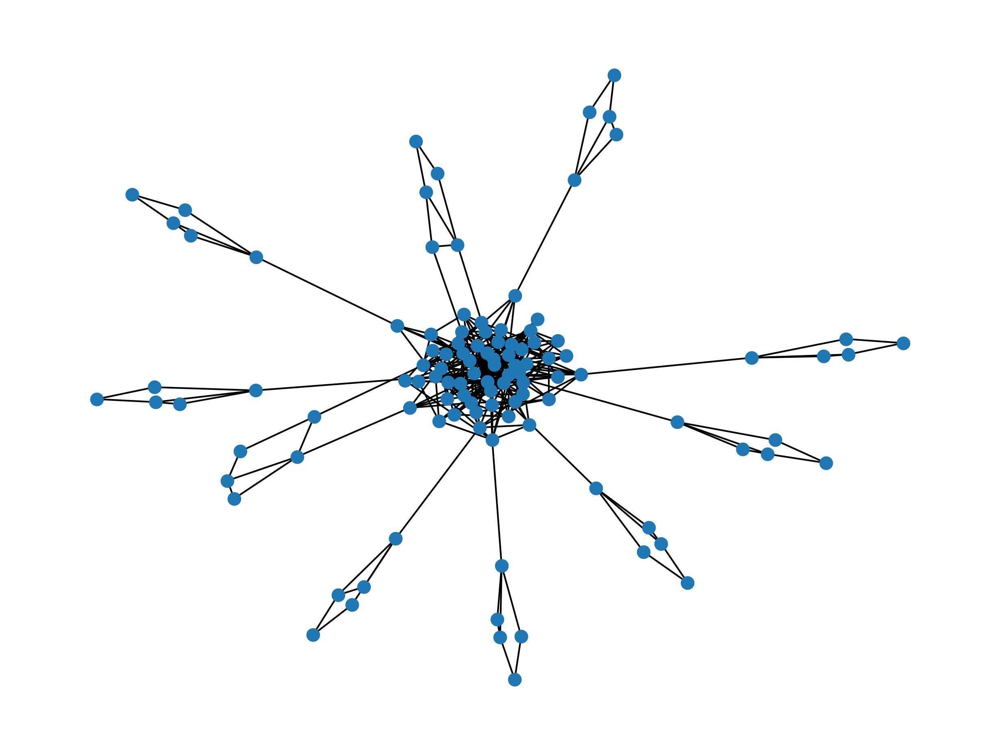

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

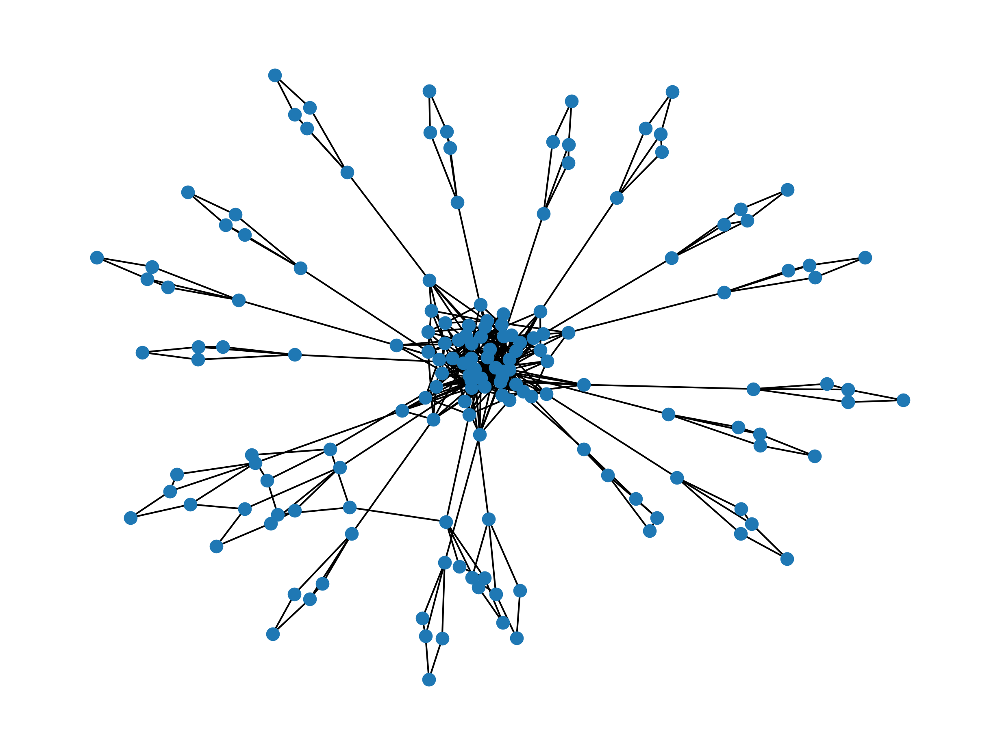

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

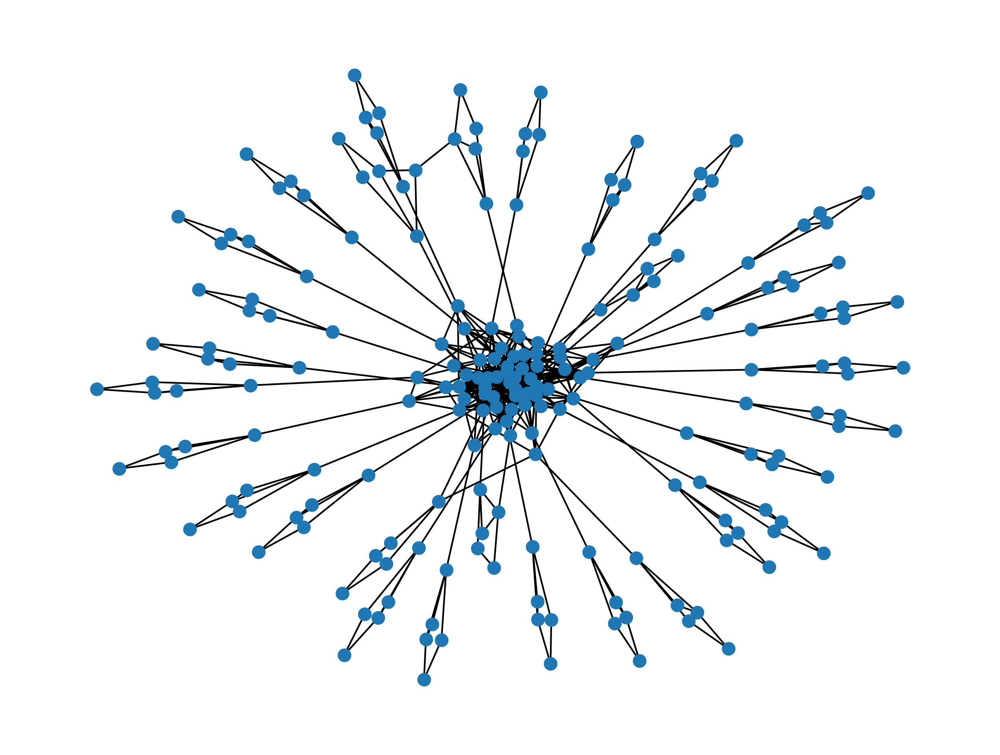

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

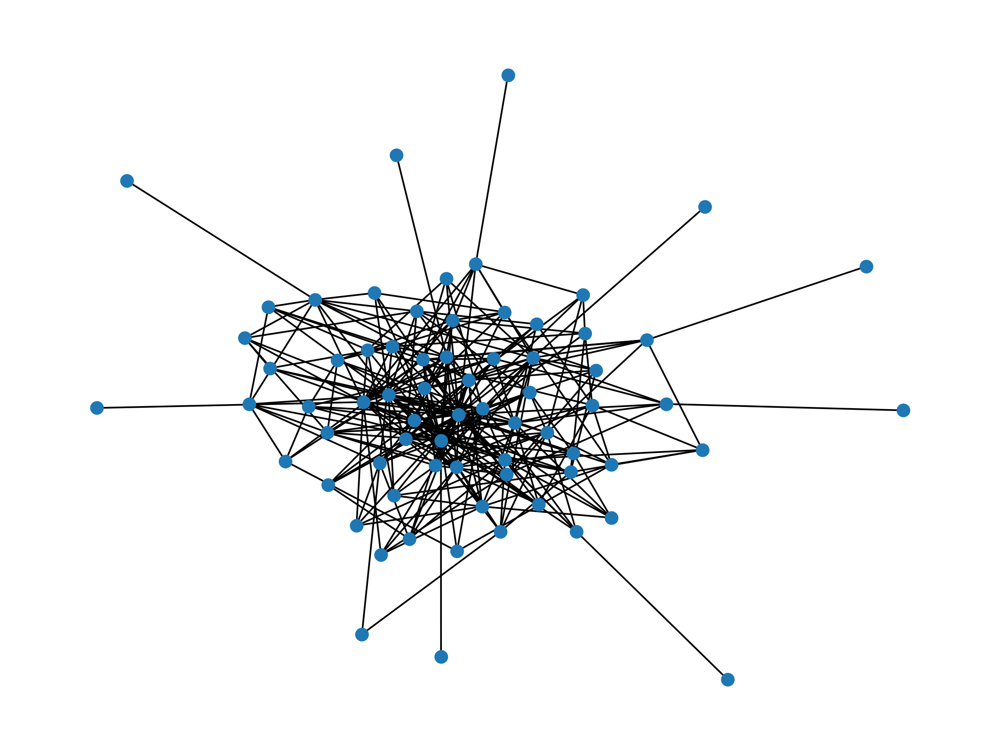

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

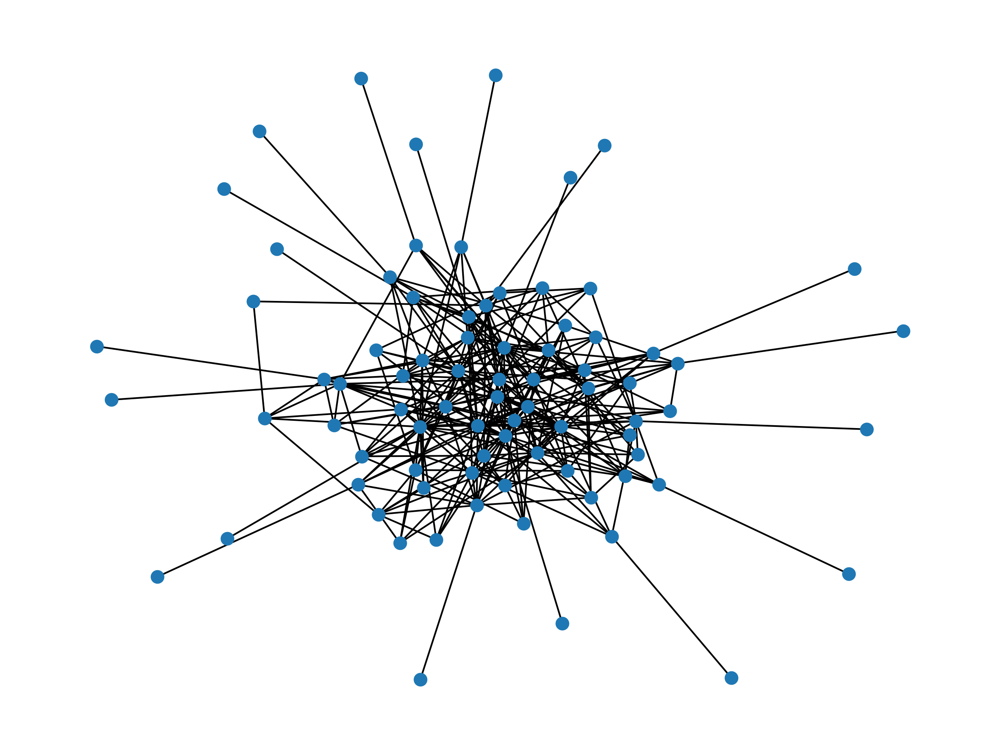

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

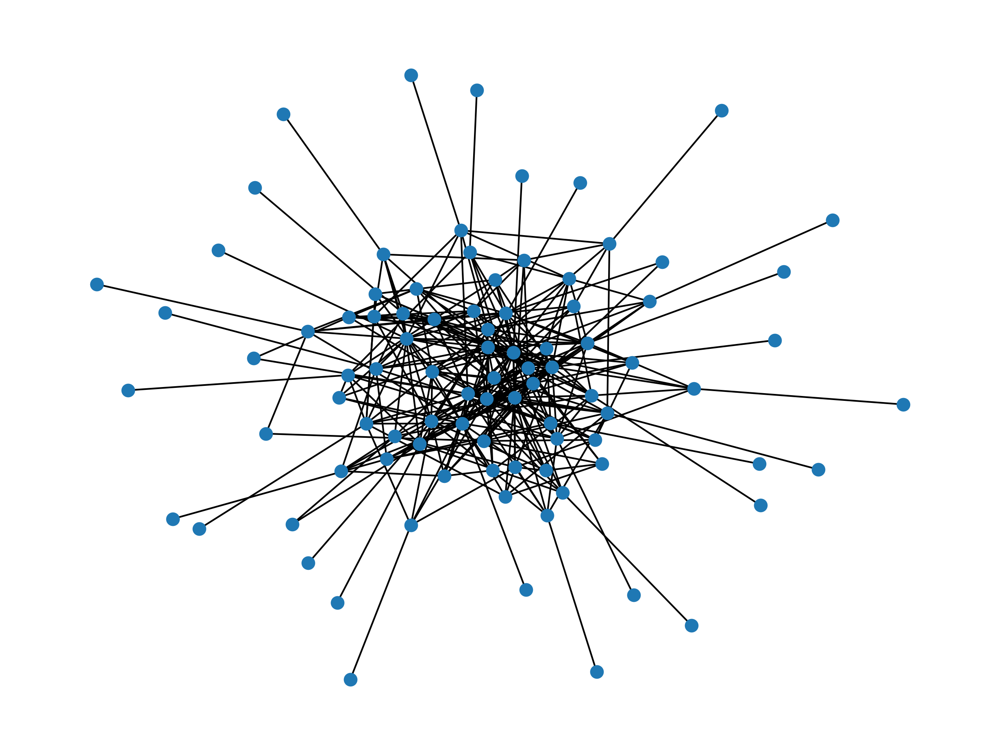

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

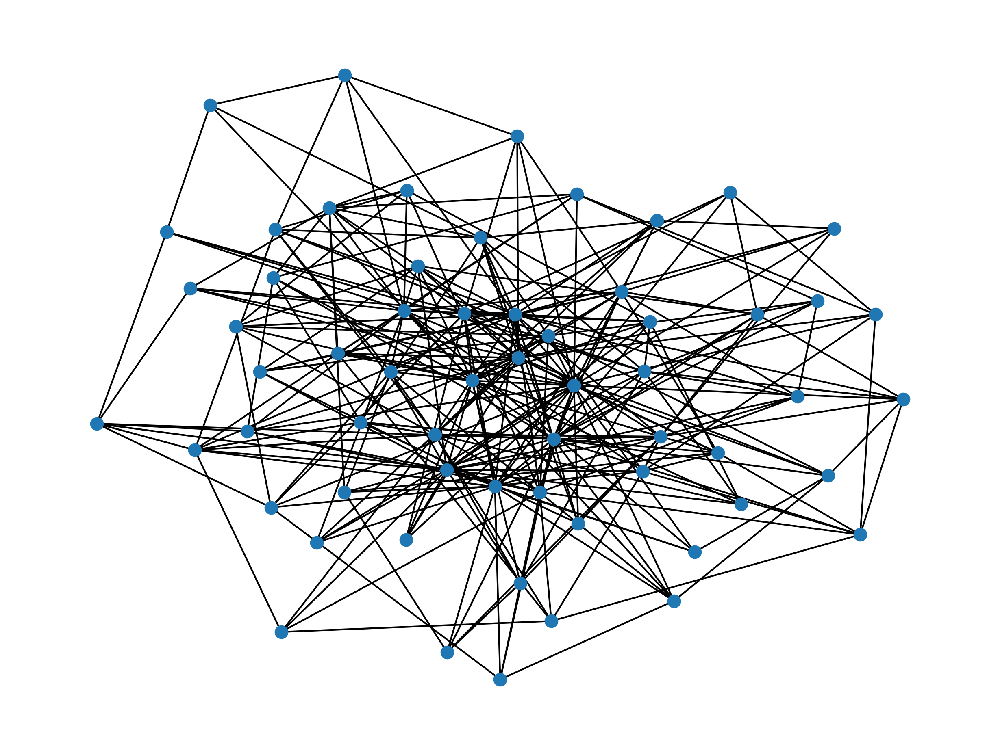

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

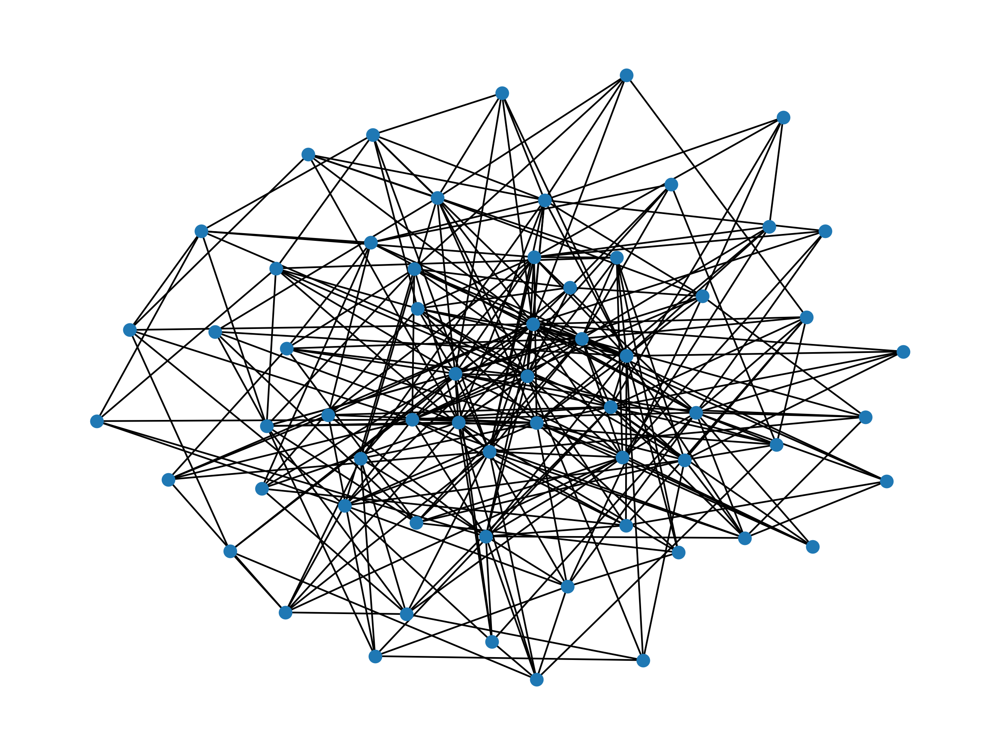

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

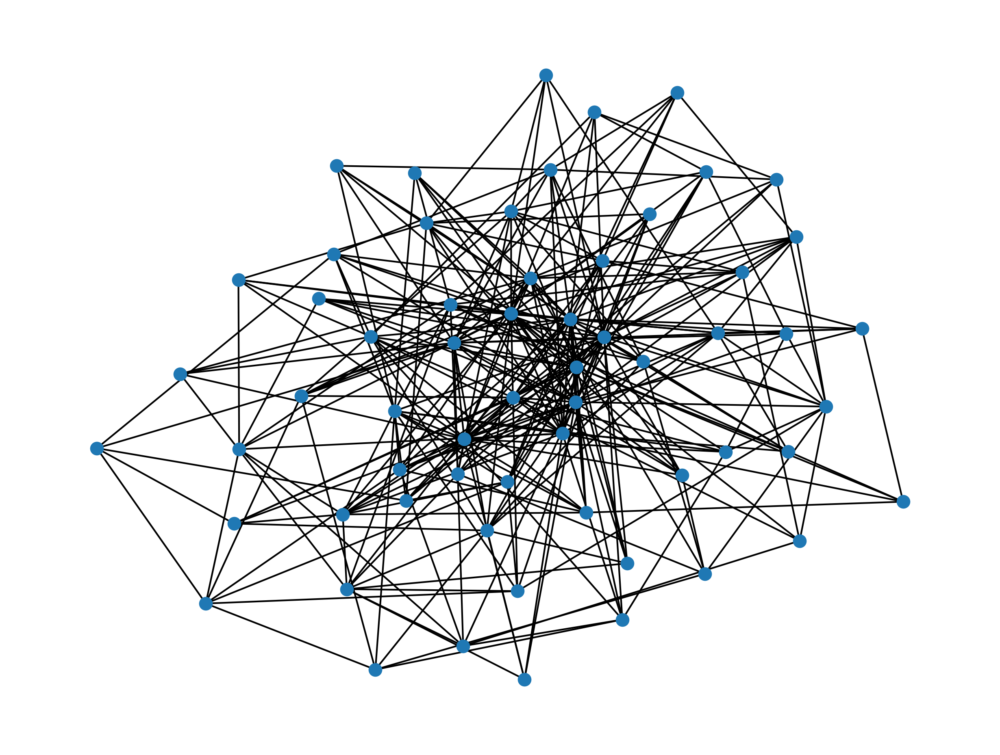

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

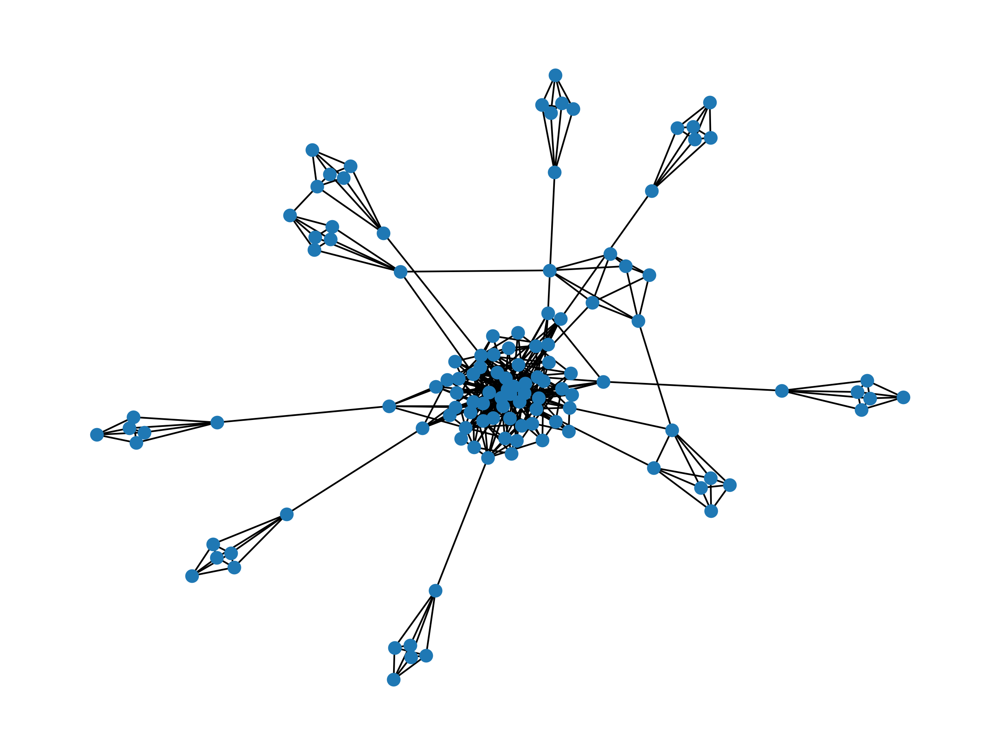

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

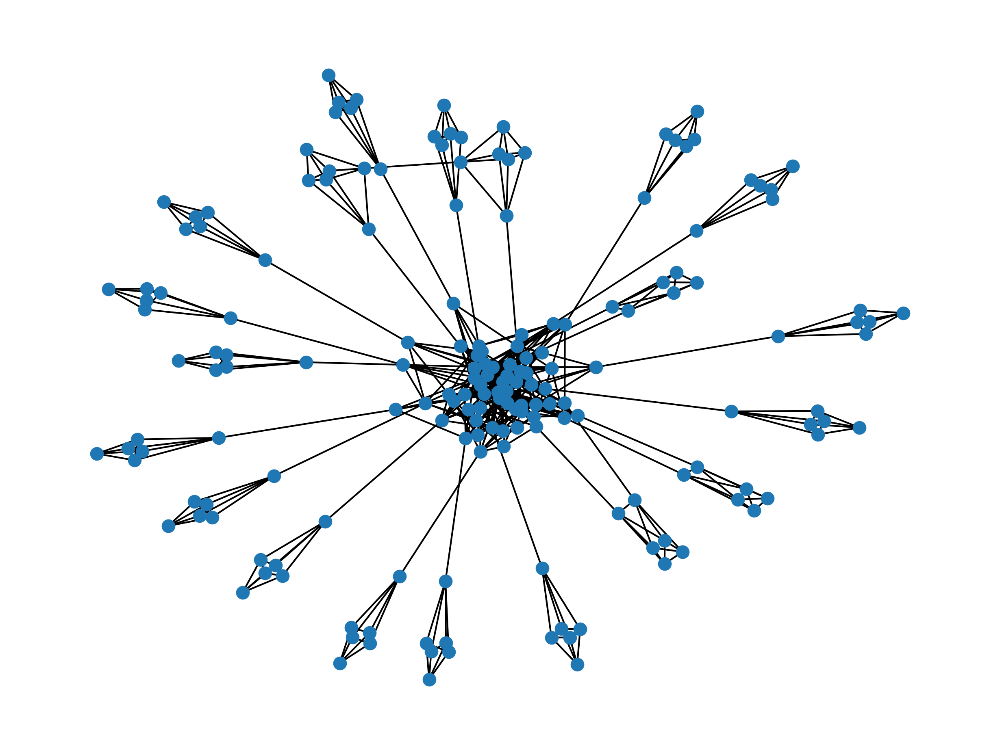

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

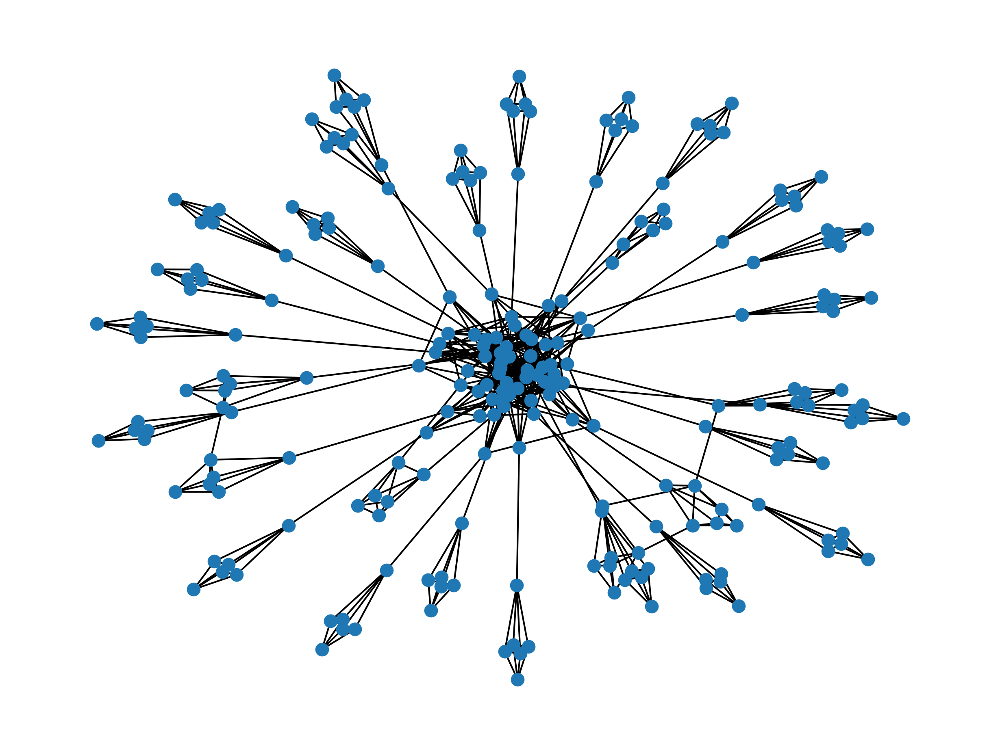

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

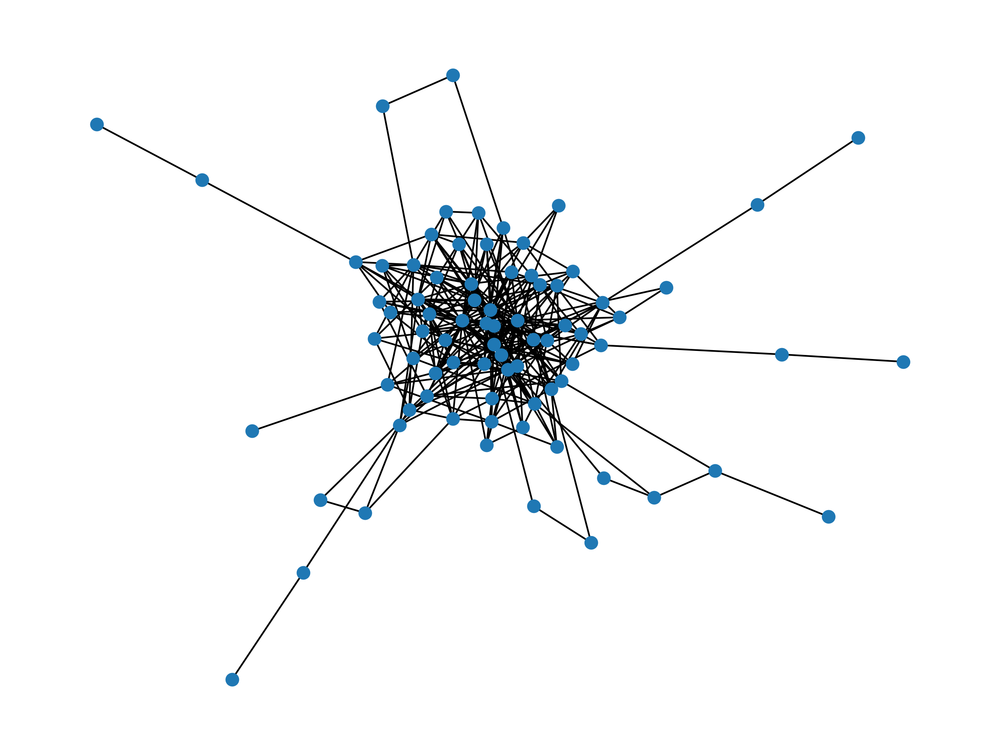

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

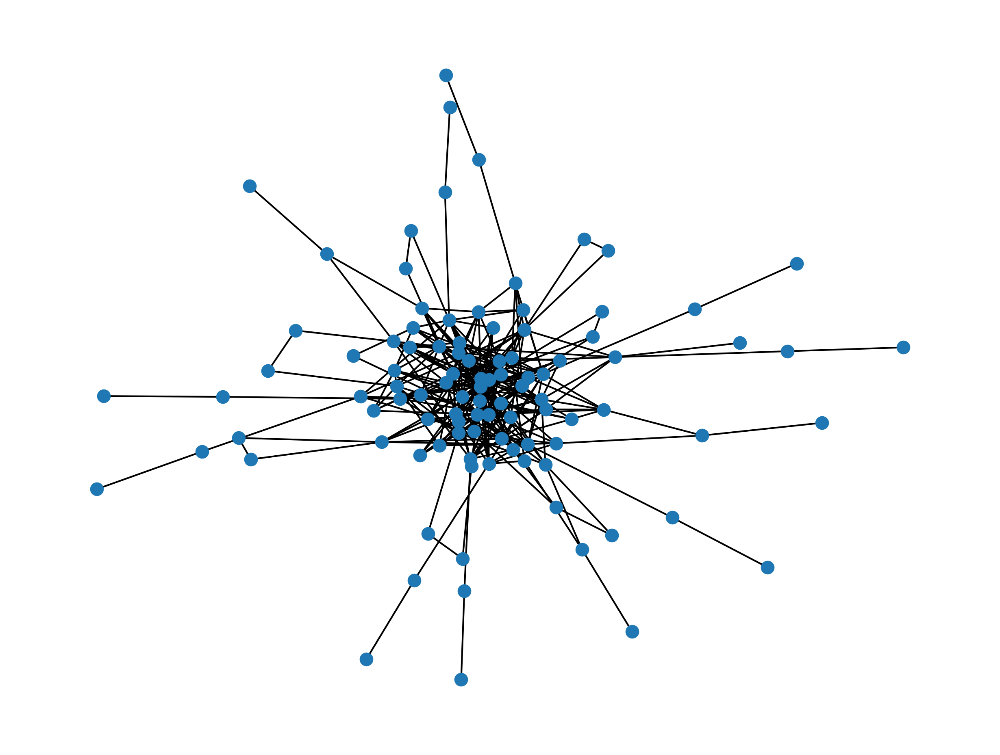

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

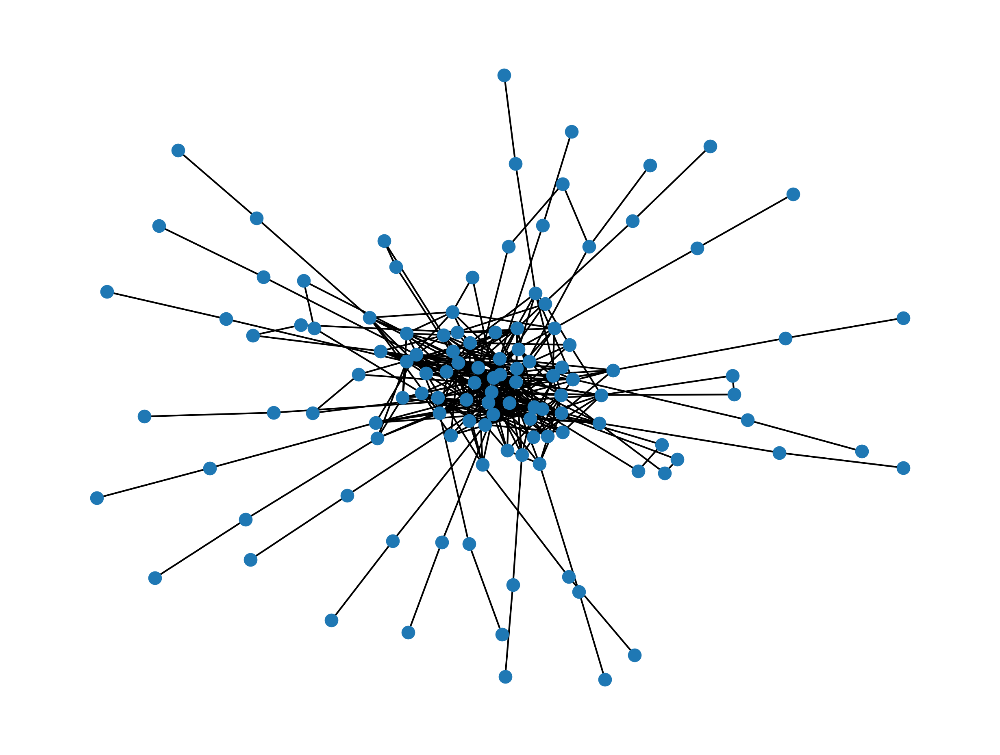

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

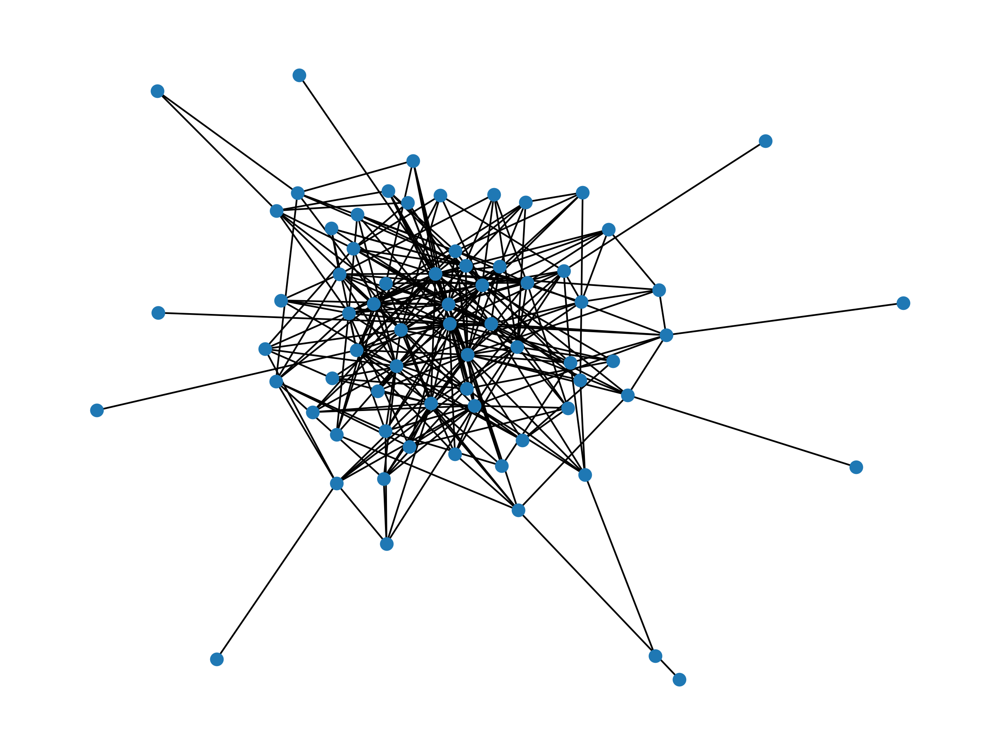

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

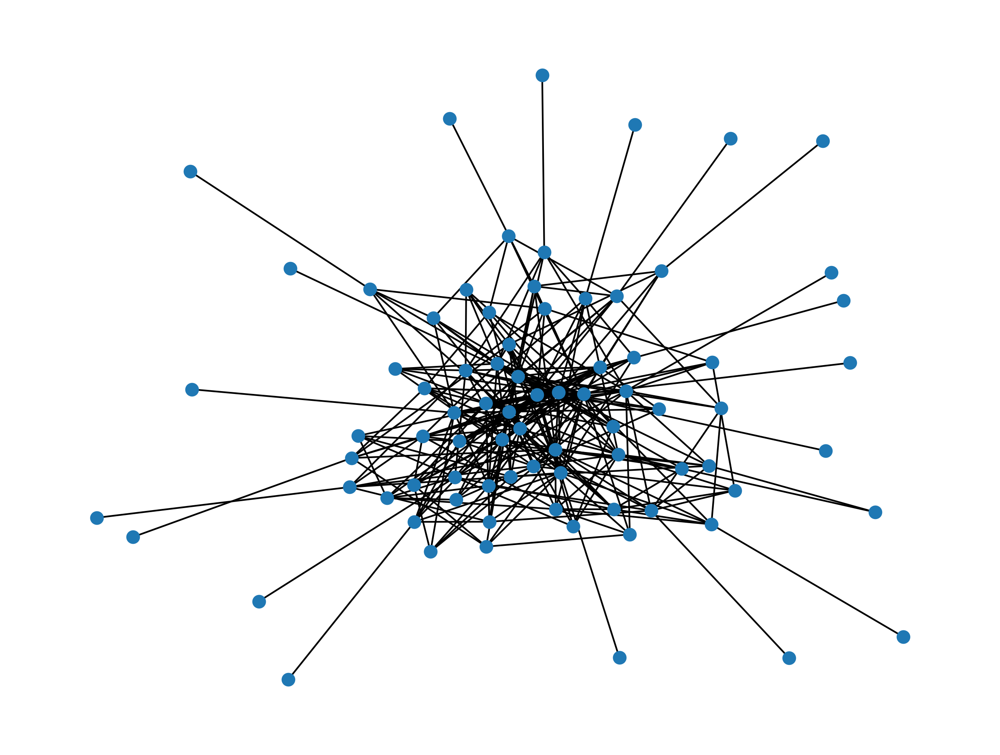

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

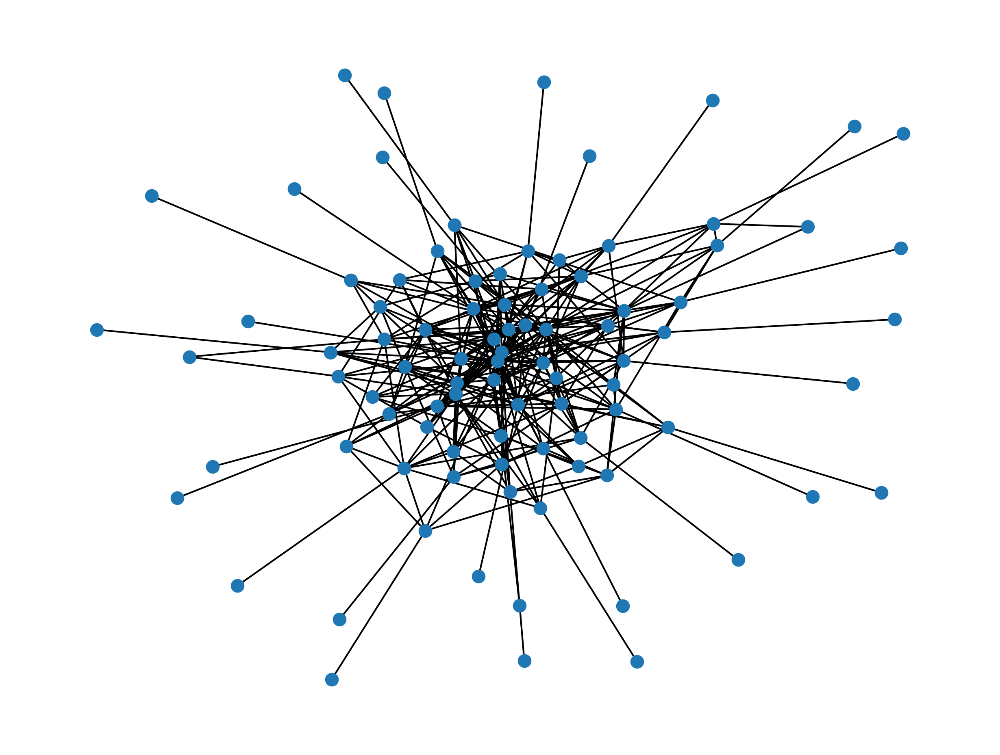

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

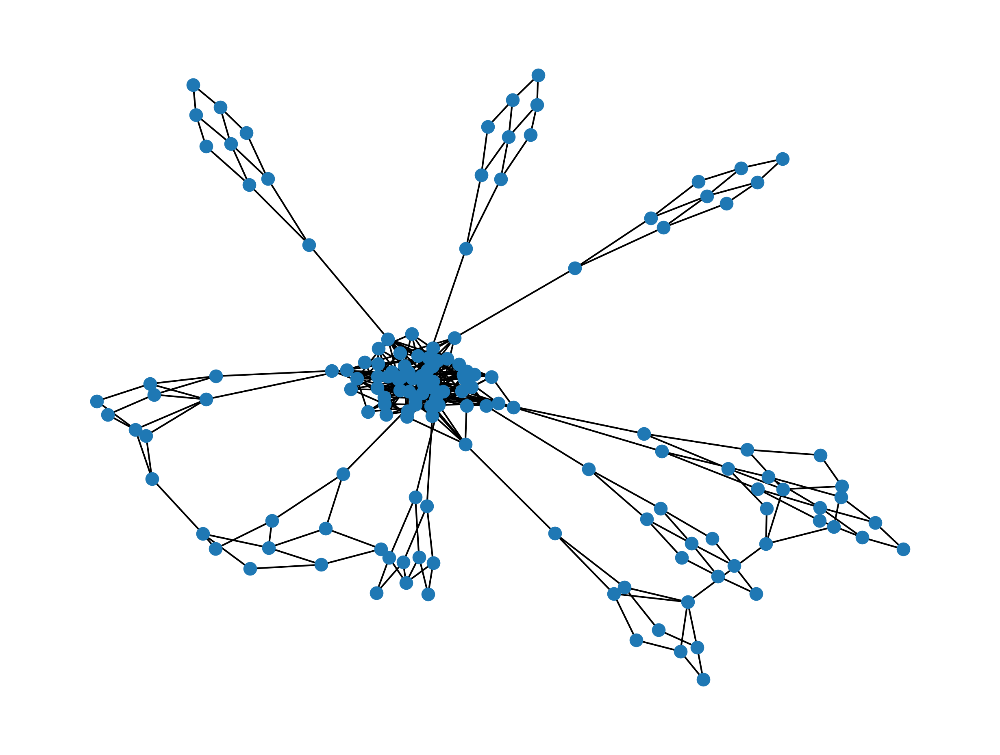

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

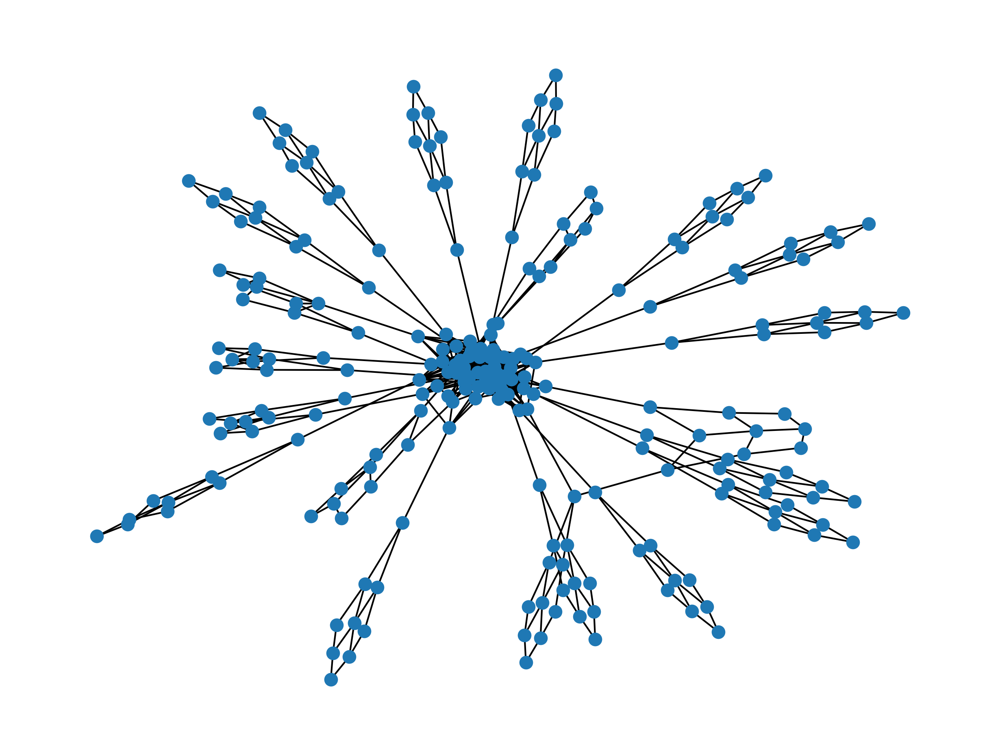

feat_dict[0]["feat"]: float32
G.nodes[0]["feat"]: float32


<Figure size 2400x1800 with 0 Axes>

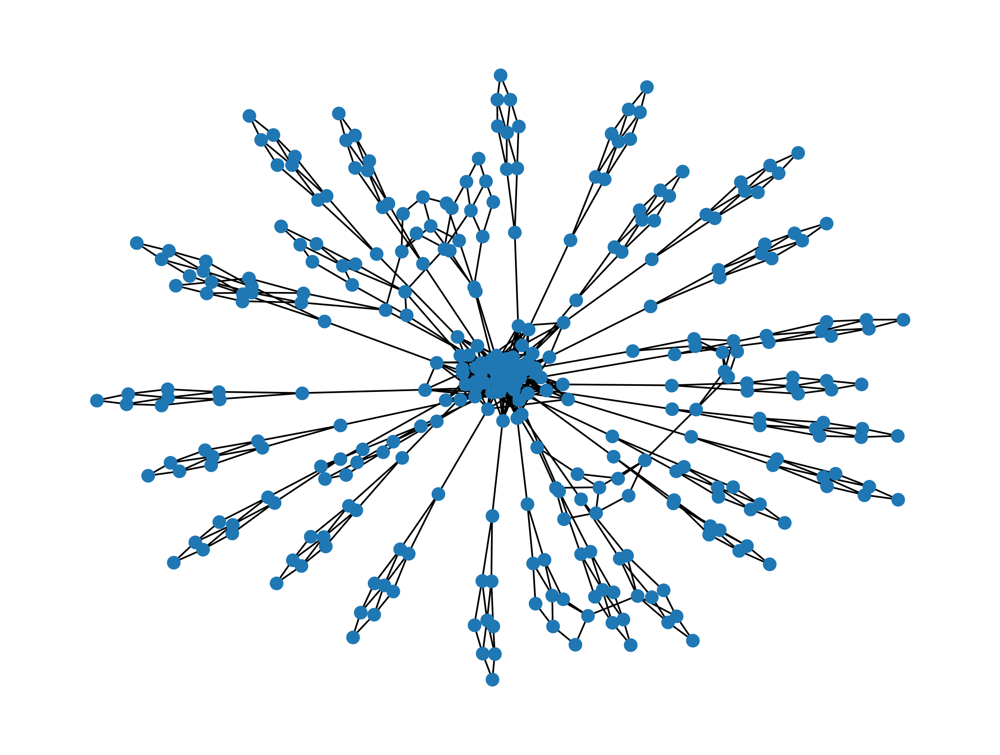

['ba_60_10_house_1', 'ba_60_20_house_2', 'ba_60_30_house_3', 'ba_60_10_fan_1', 'ba_60_20_fan_2', 'ba_60_30_fan_3', 'ba_60_10_clique_1', 'ba_60_20_clique_2', 'ba_60_30_clique_3', 'ba_60_10_diamond_1', 'ba_60_20_diamond_2', 'ba_60_30_diamond_3', 'ba_60_10_cycle_1', 'ba_60_20_cycle_2', 'ba_60_30_cycle_3', 'ba_60_10_star_1', 'ba_60_20_star_2', 'ba_60_30_star_3', 'ba_60_10_grid_1', 'ba_60_20_grid_2', 'ba_60_30_grid_3']
[[1.10000000e+02 3.48000000e+02 5.80483736e-02 1.11613833e+01
  4.80778474e+00 2.13398682e+00 2.49327025e-01]
 [1.60000000e+02 4.19000000e+02 3.29402516e-02 9.80622010e+00
  4.55008950e+00 2.45853240e+00 3.79258491e-01]
 [2.10000000e+02 4.89000000e+02 2.22829802e-02 8.40163934e+00
  3.73140520e+00 2.70443769e+00 4.49287181e-01]
 [7.00000000e+01 2.87000000e+02 1.18840580e-01 1.27591623e+01
  4.53867596e+00 1.55006391e+00 0.00000000e+00]
 [8.00000000e+01 2.97000000e+02 9.39873418e-02 1.16340641e+01
  4.19116162e+00 1.61698394e+00 0.00000000e+00]
 [9.00000000e+01 3.08000000e+02 

In [110]:
%matplotlib inline
features = []
names = []
for function in [bahouse,bafan,baclique,badiamond,bacycle,bastar,bagrid]:
    for i in range(1,4):
        G_conf,_ ,name = function(nb_shapes=10*i)
        feat = global_feature(G_conf)
        plt.figure(figsize=(8, 6), dpi=300)
        nx.draw(G_conf,nodelist=G_conf.nodes, font_color='white' ,node_size = 50, with_labels=False)
        features.append(feat)
        name = name+'_'+str(i)
        file_name =  "../Cross_Validation/GNNexplanation/New/"+name
        nx.write_edgelist(G_conf,file_name+str(".txt"))
        plt.show()
        names.append(name)
print(names)
print(np.array(features))
    

## Real World 

In [96]:
import os

import networkx as nx
import networkx.algorithms.community as nx_comm
import numpy as np
import math
from scipy.sparse.linalg import eigsh

def molloy_reed(g):
  all_degree =   np.array(g.degree())[:,1]
  degs = np.delete(all_degree,-1)
  k = degs.mean()
  k2 = np.mean(degs ** 2)
  if k ==0:
    beta = 0
  else:
    beta = k2/k
  return beta 

def get_power_law_exponent(self):
    alpha = 1 + self.N / sum(np.log(self.degs/mink))
    return alpha

    
def global_feature(g): 
    subGraph = g#g.subgraph(np.arange(len(g)-1)) #for supernode
    M = len(subGraph.edges())
    N = len(subGraph)
    degs =   np.array(subGraph.degree())[:,1]
    min_k = np.min(degs)
    
    k1 = degs.mean()
    k2 = np.mean(degs** 2)
    div = k2 - k1**2
    A = nx.to_scipy_sparse_matrix(g, weight='weight',dtype=np.float,format='csr')
    adj_lams = np.sort(eigsh(A, k=N-1, which='LA', return_eigenvectors=False))
    nodes = N
    edges = M
    heterogeneity = div/k1
    density = (2*M)/(N*(N-1))
    resilience = molloy_reed(g)
    power_law_exponent = 1 + N / sum(np.log(degs/min_k))
    modularity = nx_comm.modularity(g,nx_comm.label_propagation_communities(g))
    varepsilons = nx.algorithms.distance_measures.eccentricity(g).values()
    eccentricity=  np.mean(list(varepsilons))
    diameter = nx.algorithms.distance_measures.diameter(g)
    radius = nx.algorithms.distance_measures.radius(g)
    spectral_radius=adj_lams[-1]
    spectral_gap=  adj_lams[-1]-adj_lams[-2]
    natural_connectivity= np.log2(sum(np.exp(np.real(adj_lams)))/len(adj_lams))
    global_efficiency = nx.algorithms.efficiency_measures.global_efficiency(g)
    global_properties =np.hstack((nodes, edges,density,resilience,heterogeneity,power_law_exponent, modularity,eccentricity,diameter,radius,spectral_radius,spectral_gap,natural_connectivity))
    return global_properties

features = []
names = []
path_of_the_directory= "real"

filename = ["test","testTrain","corruption","foodweb-baywet","inf-USAir97","moreno_crime_projected",'opsahl-openflights','household','faa','facebook','powergrid','netscience']
#filename = ["test","testTrain","corruption","foodweb-baywet","inf-USAir97","moreno_crime_projected",'faa','facebook','powergrid','netscience']
filepath = ["../real/"+file+".txt" for file in filename] 
'''
filename = ['ba_300_20_house_1', 'ba_300_40_house_2', 'ba_300_60_house_3', 'ba_300_80_house_4', 'ba_300_100_house_5', 'ba_300_20_grid_1', 'ba_300_40_grid_2', 'ba_300_60_grid_3', 'ba_300_80_grid_4', 'ba_300_100_grid_5', 'tree_8_20_cycle_1', 'tree_8_40_cycle_2', 'tree_8_60_cycle_3', 'tree_8_80_cycle_4', 'tree_8_100_cycle_5', 'tree_8_20_grid_1', 'tree_8_40_grid_2', 'tree_8_60_grid_3', 'tree_8_80_grid_4', 'tree_8_100_grid_5']
filepath = ["../Cross_Validation/GNNexplanation/"+file+".txt" for file in filename]
'''
for file in filepath:
    print(file)
    fh = open(file, "rb")
    G_conf = nx.read_edgelist(fh)
    fh.close()
    lcc = max(nx.connected_components(G_conf), key=len)
    G_conf = G_conf.subgraph(lcc)
    nodes = G_conf.nodes()
    map = {n:int(i) for i, n in enumerate(nodes)}
    #GRAPH = reset(add_super_node(nx.relabel_nodes(GRAPH, map)))
    G_conf =  nx.relabel_nodes(G_conf, map)
    G_conf.remove_edges_from(nx.selfloop_edges(G_conf))
    G_conf.remove_nodes_from(nx.isolates(G_conf))
    feat = global_feature(G_conf)
    features.append(feat)
print(np.array(features))

../real/test.txt
../real/testTrain.txt
../real/corruption.txt


/tmp/ipykernel_8203/3508101624.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  A = nx.to_scipy_sparse_matrix(g, weight='weight',dtype=np.float,format='csr')


../real/foodweb-baywet.txt
../real/inf-USAir97.txt
../real/moreno_crime_projected.txt
../real/opsahl-openflights.txt
../real/household.txt
../real/faa.txt
../real/facebook.txt
../real/powergrid.txt
../real/netscience.txt
[[1.70000000e+01 1.70000000e+01 1.25000000e-01 3.30303030e+00
  1.23529412e+00 3.21415762e+00 4.48096886e-01 4.29411765e+00
  5.00000000e+00 3.00000000e+00 2.92069242e+00 8.91991372e-01
  1.46892545e+00]
 [5.00000000e+01 1.84000000e+02 1.50204082e-01 1.03516484e+01
  2.92260870e+00 3.13906005e+00 0.00000000e+00 2.98000000e+00
  4.00000000e+00 2.00000000e+00 9.78139874e+00 5.71596089e+00
  8.52071314e+00]
 [3.09000000e+02 3.28100000e+03 6.89488505e-02 3.49304984e+01
  1.36890817e+01 1.37170794e+00 6.75389581e-01 5.28155340e+00
  7.00000000e+00 4.00000000e+00 4.65126424e+01 9.92453240e+00
  5.88368426e+01]
 [1.28000000e+02 2.07500000e+03 2.55290354e-01 4.02034884e+01
  7.68511295e+00 1.37534330e+00 0.00000000e+00 2.85937500e+00
  3.00000000e+00 2.00000000e+00 3.96313826e